<a href="https://colab.research.google.com/github/himasai97/GANs/blob/main/ConditionalGAN/ConditionalGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes

def tensor_image_viz(tensor_img, num_images=25, size=(1,28,28), nrow=5, show=True):
  '''
  To visualize images
  Parameters: a tensor of images, number of images and size per image
  Output: prints the images in a uniform grid
  '''
  tensor_img = (tensor_img + 1) / 2
  image_unflat = tensor_img.detach().cpu()
  image_grid = make_grid(image_unflat[:num_images], nrow= nrow)
  plt.imshow(image_grid.permute(1,2,0).squeeze())
  if show:
    plt.show()

# Generator and Noise

In [2]:
class Generator(nn.Module):
  '''
  Generator Class with values:
      in_dim: the dimension of the input vector, a scalar
      img_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so here im_chan = 1)
      hidden_dim: the initial hidden layer output dimension, a scalar
  '''
  def __init__(self, in_dim, img_chan=1, hidden_dim=64):
    super(Generator, self).__init__()
    self.in_dim = in_dim
    # building the neural network
    self.gen = nn.Sequential(
        self.get_gen_block(in_dim, hidden_dim*4),
        self.get_gen_block(hidden_dim*4, hidden_dim*2, kernel_size=4, stride=1),
        self.get_gen_block(hidden_dim*2, hidden_dim),
        self.get_gen_block(hidden_dim, img_chan, kernel_size=4, final_layer=True),
    )
  
  def get_gen_block(self, in_chan, out_chan, kernel_size=3, stride=2, final_layer=False):
    '''
    To create a block of generator's neural network
    Parameters:
          in_chan: number of channels that the input feature for that layer has, a scalar
          out_chan: number of channels that the input feature for that layer should have, a scalar
          kernel_size: to determine the size of each convolution filter, equivalent to (kernel_size, kernel_size)
          stride: the amount by which the kernel is shifted when sliding across the input feature
          final_layer: a boolean indicating whether the given layer is the final layer (value is true in that case and false otherwise)
    Returns:
          a generator neural network layer consisting of:
            Transposed Convolution layer
            Batch Normalization (for stabilization)
            ReLU (a non linear transformation to transform the output)
          if final_layer:
            Transposed Convolution layer
            Tanh activation      
    '''
    if not final_layer:
      return nn.Sequential(
          nn.ConvTranspose2d(in_chan, out_chan, kernel_size, stride),
          nn.BatchNorm2d(out_chan),
          nn.ReLU(inplace=True),
      )
    else:
      return nn.Sequential(
          nn.ConvTranspose2d(in_chan, out_chan, kernel_size, stride),
          nn.Tanh(),
      )
  
  def forward(self, noise):
    '''
    To complete a forward pass of the generator after reshaping the noise vector
    Parameters:
        noise: a tensor with (n_samples, in_dim) dimensions
    Returns:
        a batch of generated images
    '''
    x = noise.view(len(noise), self.in_dim, 1, 1)
    return self.gen(x)

def get_noise(n_samples, in_dim, device='cpu'):
  '''
  For creating noise vectors
  Parameters:
        n_samples: the number of samples to generate, a scalar
        in_dim: the dimension of the input vector, a scalar
        device: the device type
  Returns:
        a tensor filled with random numbers of (n_samples, in_dim) dimension
  '''
  return torch.randn(n_samples, in_dim, device=device)

# Discriminator

In [3]:
class Discriminator(nn.Module):
  '''
  Discriminator Class with values:
      img_chan: the number of channels that the output image has, a scalar
            (MNIST is black-and-white, so here img_chan=1)
      hidden_dim: the initial hidden layer output dimension, a scalar
  '''
  def __init__(self, img_chan=1, hidden_dim=64):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        self.get_disc_block(img_chan, hidden_dim),
        self.get_disc_block(hidden_dim, hidden_dim*2),
        self.get_disc_block(hidden_dim*2, 1, final_layer=True),
    )
  
  def get_disc_block(self, in_chan, out_chan, kernel_size=4, stride=2, final_layer=False):
    '''
    To create a discriminator block 
    Parameters:
          in_chan: number of channels that the input feature for that layer has, a scalar
          out_chan: number of channels that the input feature for that layer should have, a scalar
          kernel_size: to determine the size of each convolution filter, equivalent to (kernel_size, kernel_size)
          stride: the amount by which the kernel is shifted when sliding across the input feature
          final_layer: a boolean indicating whether the given layer is the final layer (value is true in that case and false otherwise)
    Returns:
          a discriminator neural network layer consisting of:
            Convolution layer
            Batch Normalization (for stabilization)
            Leaky ReLU (with slope of 0.2)
          if final_layer:
            Convolution layer
    '''  
    if not final_layer:
      return nn.Sequential(
          nn.Conv2d(in_chan, out_chan, kernel_size, stride),
          nn.BatchNorm2d(out_chan),
          nn.LeakyReLU(0.2, inplace=True),
      )
    else:
      return nn.Sequential(
          nn.Conv2d(in_chan, out_chan, kernel_size, stride),
      )

  def forward(self, image):
    '''
    To complete a forward pass of the discriminator 
    Parameters:
        image: a flattened image tensor with (im_chan) dimension
    Returns:
        a 1-D tensor indicating whether the image is fake/real
    '''
    disc_pred = self.disc(image)
    return disc_pred.view(len(disc_pred), -1)

# Class Input
In conditional GANs, the input vector for the generator also includes the class information, represented as a one-hot encoded vector. 

In [4]:
import torch.nn.functional as F

def get_one_hot_labels(labels, n_classes):
  '''
  Creates one-hot encoded vectors for the labels
  Parameters:
        labels: tensor of labels from the dataloader of n_samples size
        n_classes: the total number of classes in the dataset, an integer scalar
  Returns:
        a one-hot encoded vector of (n_samples, n_classes) dimension
  '''
  return F.one_hot(labels, n_classes)

In [5]:
def combine_vectors(x,y):
  '''
  For combining two vectors 
  Parameters:
        x: the first vector with shape (n_samples, noise_dim) 
        y: the second vector with shape (n_samples, n_classes)
  Returns:
        combined: the combined vector with shape (n_samples, noise_dim + n_classes), a float tensor 
  '''
  combined = torch.cat((x.float(), y.float()), 1)
  return combined

# Training Initializations

In [6]:
## used as default values
mnist_shape = (1, 28, 28) # as each MNIST image is of size 28x28 pixels and has one color channel
n_classes = 10 # as the digits range from 0 to 9

# Set parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
noise_dim = 64
viz_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

# Transform the image values to be between -1 and 1, the range of the tanh activation
transform = transforms.Compose([
                  transforms.ToTensor(),
                  transforms.Normalize((0.5,), (0.5,)),
                ])

# Load the MNIST data
dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size = batch_size,
    shuffle = True)



Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [7]:
def get_input_dim(noise_dim, mnist_shape, n_classes):
  '''
  To get the size of the conditional input dimension
  Parameters:
        noise_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1,28,28)
        n_classes: the total number of classes in the dataset, an integer scalar
            (10 for MNIST)
  Returns:
        gen_in_dim: the input dimensionality of the conditional generator,
                    which takes the noise and class vectors
        disc_img_chan: the number of input channels to the discriminator
                  (10+1 for MNIST)
  '''
  gen_in_dim = noise_dim + n_classes
  disc_img_chan = mnist_shape[0] + n_classes
  return gen_in_dim, disc_img_chan

In [8]:
gen_in_dim, disc_img_chan = get_input_dim(noise_dim, mnist_shape, n_classes)

gen = Generator(in_dim=gen_in_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(img_chan=disc_img_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
  '''
  To initialize the weights by sampling values from the normal distribution
  with mean 0 and standard deviation 0.02
  '''
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)

gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

# Putting it all together!

Step 500: Generator loss: 2.2020571373701094, Discriminator's loss: 0.2549489556252956


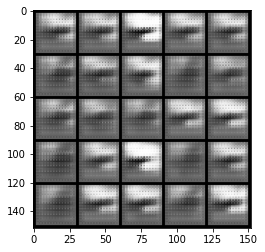

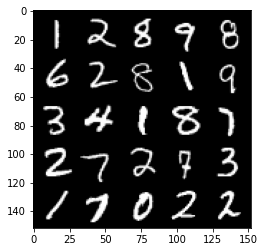

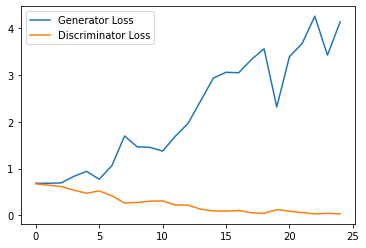

Step 1000: Generator loss: 3.653038766503334, Discriminator's loss: 0.1268475422570482


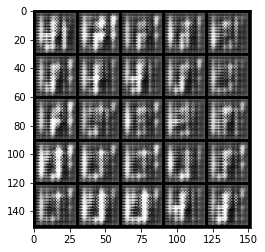

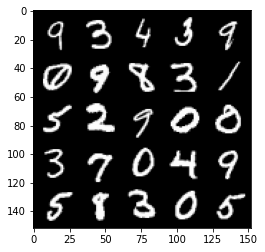

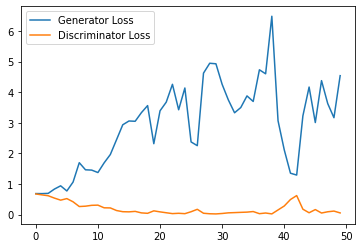

Step 1500: Generator loss: 3.646966601371765, Discriminator's loss: 0.09626920033246279


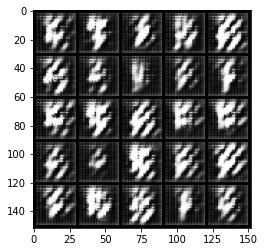

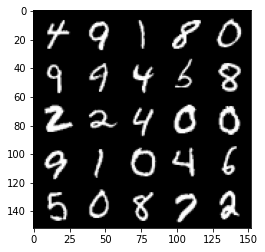

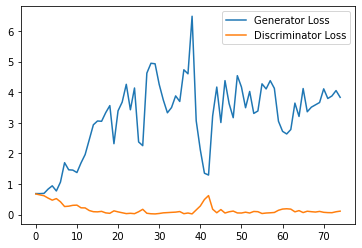

Step 2000: Generator loss: 3.70984290266037, Discriminator's loss: 0.10210701226815581


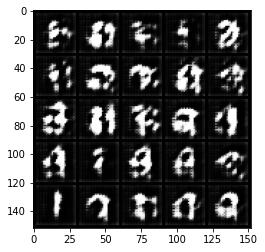

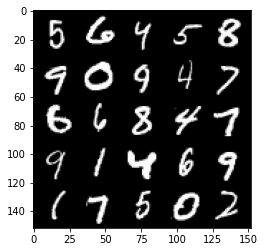

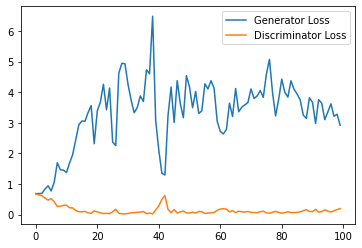

Step 2500: Generator loss: 2.5295785937309265, Discriminator's loss: 0.21874900552630425


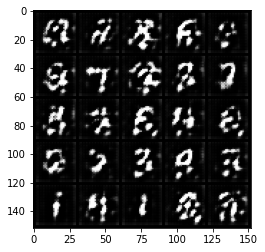

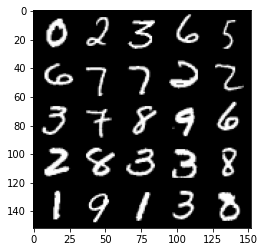

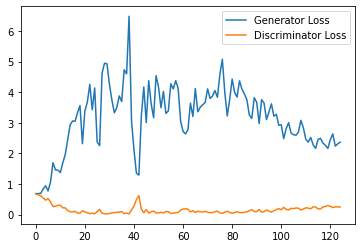

Step 3000: Generator loss: 2.1320033366680144, Discriminator's loss: 0.30499382069706915


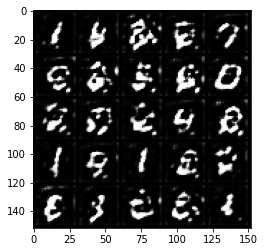

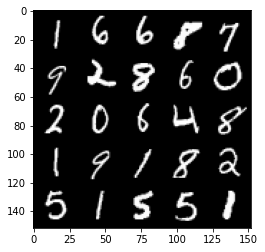

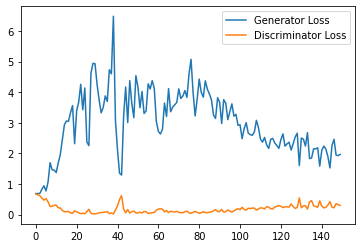

Step 3500: Generator loss: 2.166040658712387, Discriminator's loss: 0.29361901950836183


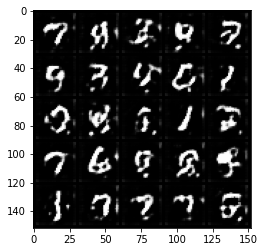

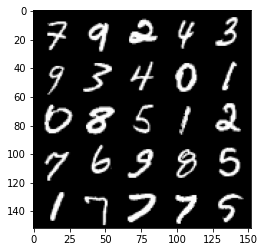

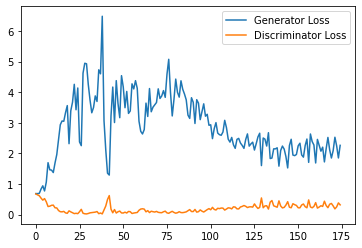

Step 4000: Generator loss: 2.1859730043411254, Discriminator's loss: 0.30453416594862937


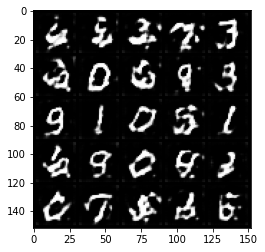

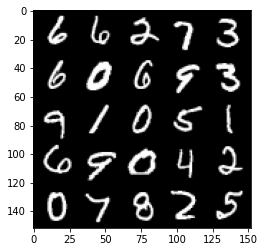

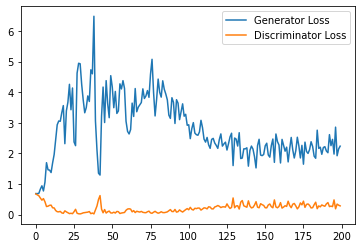

Step 4500: Generator loss: 2.078936414003372, Discriminator's loss: 0.3235919599682093


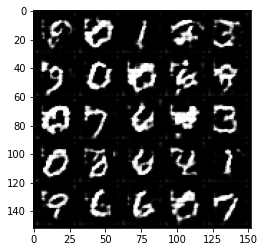

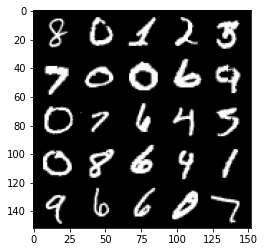

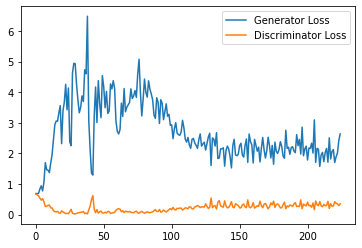

Step 5000: Generator loss: 1.9644793016910553, Discriminator's loss: 0.35695375481247904


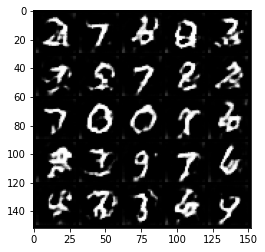

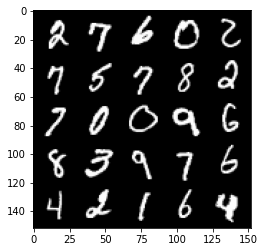

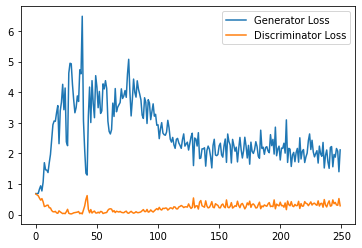

Step 5500: Generator loss: 1.8127786098718643, Discriminator's loss: 0.36896713930368424


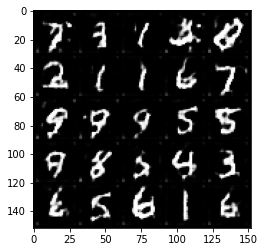

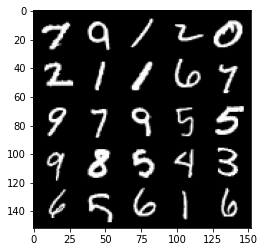

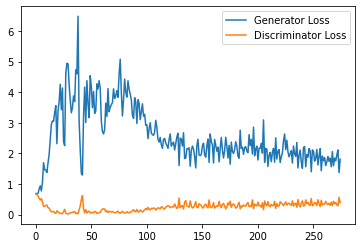

Step 6000: Generator loss: 1.7541597905158997, Discriminator's loss: 0.38500430253148077


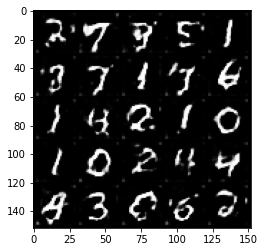

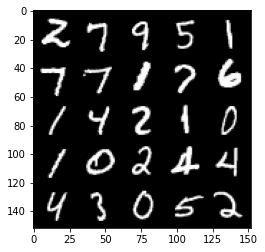

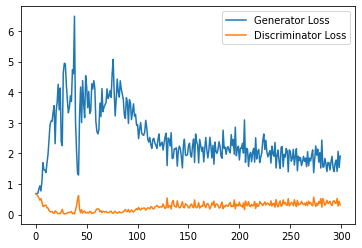

Step 6500: Generator loss: 1.644067906141281, Discriminator's loss: 0.4179306581020355


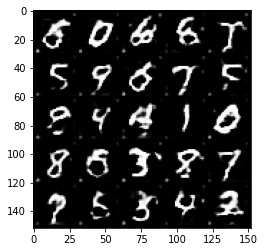

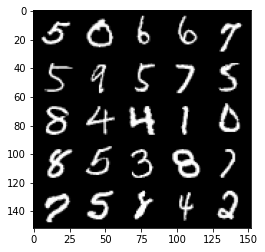

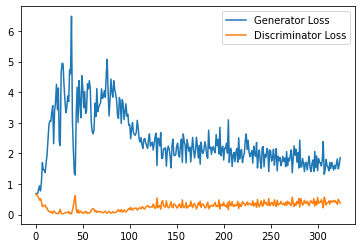

Step 7000: Generator loss: 1.6038923727273942, Discriminator's loss: 0.44041870537400246


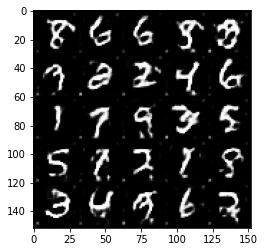

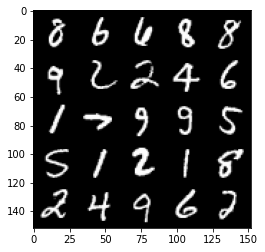

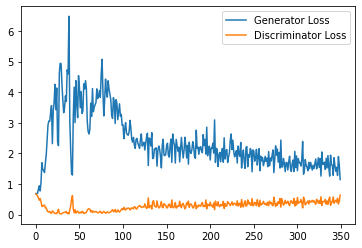

Step 7500: Generator loss: 1.5591316629648209, Discriminator's loss: 0.44174479925632476


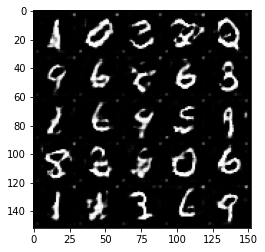

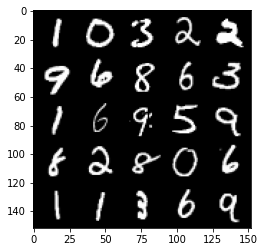

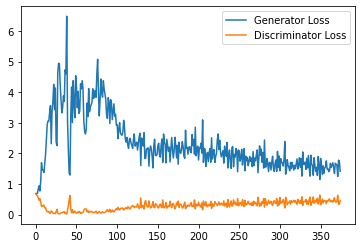

Step 8000: Generator loss: 1.4969860714673997, Discriminator's loss: 0.45416095209121704


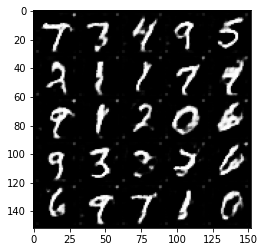

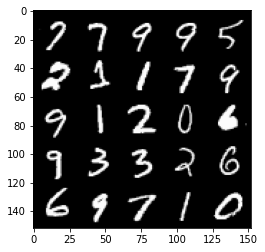

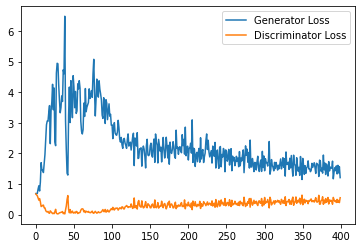

Step 8500: Generator loss: 1.454088786482811, Discriminator's loss: 0.474281405210495


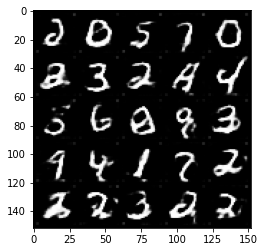

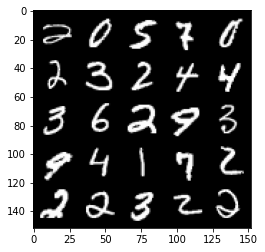

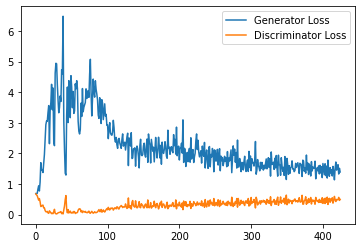

Step 9000: Generator loss: 1.428140473484993, Discriminator's loss: 0.48431199699640276


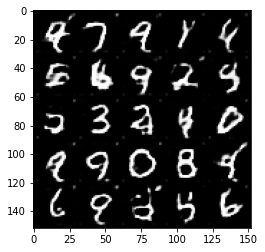

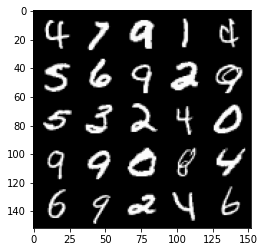

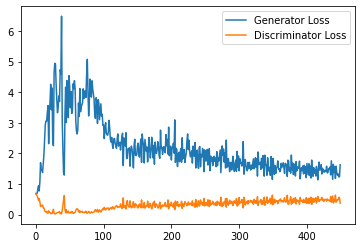

Step 9500: Generator loss: 1.3340253092050551, Discriminator's loss: 0.5214599947333336


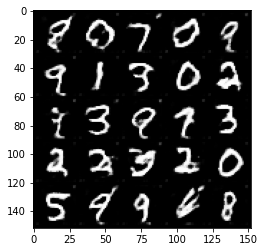

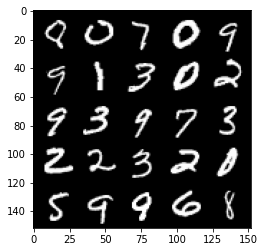

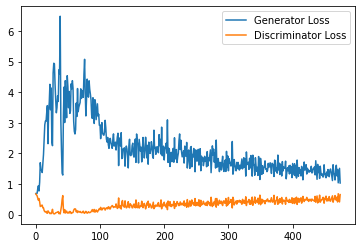

Step 10000: Generator loss: 1.2939572405815125, Discriminator's loss: 0.5224048182964325


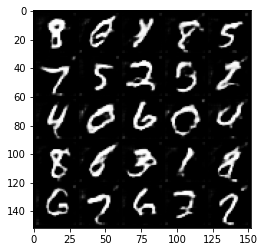

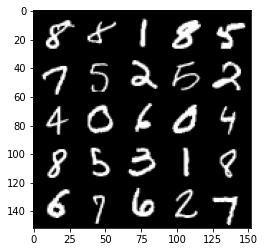

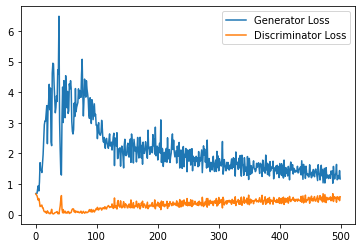

Step 10500: Generator loss: 1.2467952979803085, Discriminator's loss: 0.5353725496530533


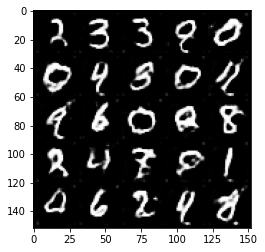

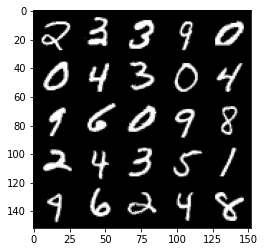

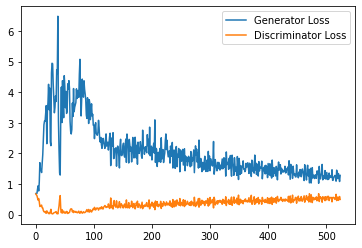

Step 11000: Generator loss: 1.250326401114464, Discriminator's loss: 0.5386245560646057


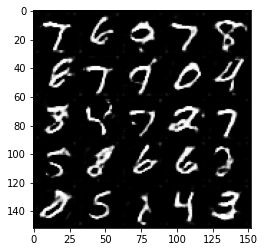

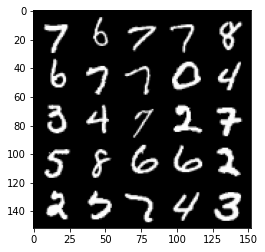

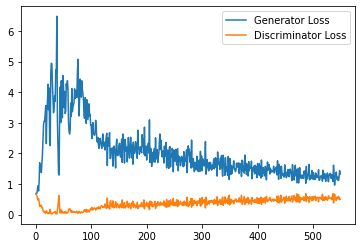

Step 11500: Generator loss: 1.1861050089597702, Discriminator's loss: 0.55073207706213


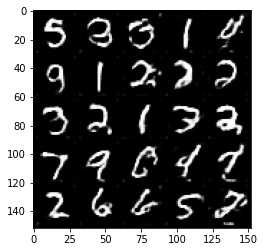

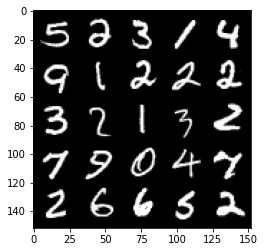

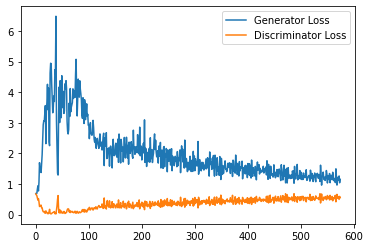

Step 12000: Generator loss: 1.1599209344387054, Discriminator's loss: 0.5630508113503456


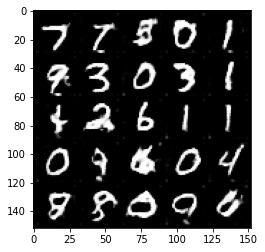

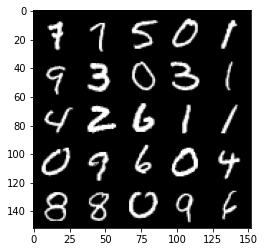

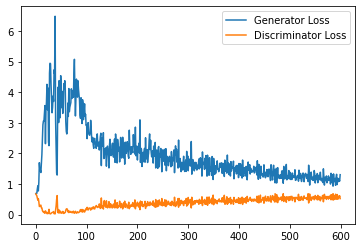

Step 12500: Generator loss: 1.1837802152633667, Discriminator's loss: 0.566841336786747


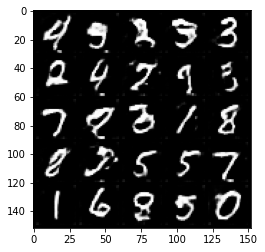

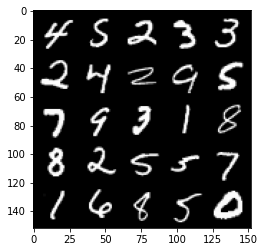

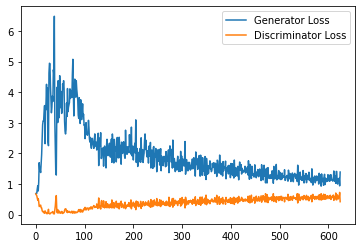

Step 13000: Generator loss: 1.1267233200073241, Discriminator's loss: 0.5696943222880363


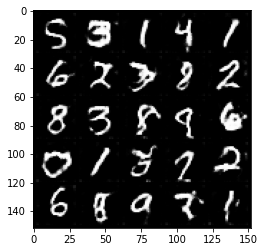

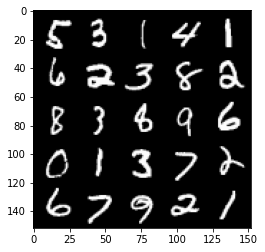

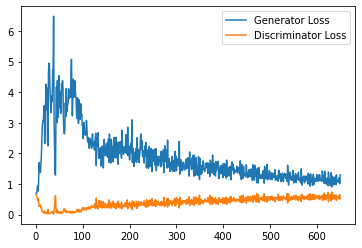

Step 13500: Generator loss: 1.1809199701547624, Discriminator's loss: 0.5784854084253311


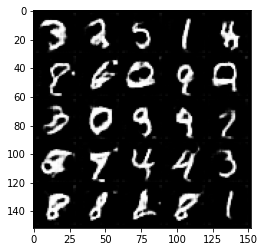

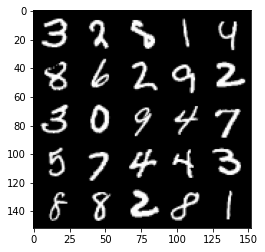

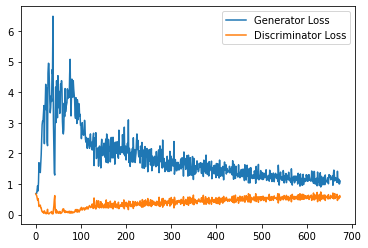

Step 14000: Generator loss: 1.1189040603637694, Discriminator's loss: 0.5749636870026589


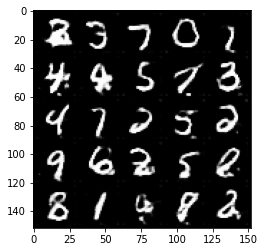

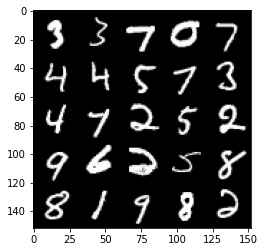

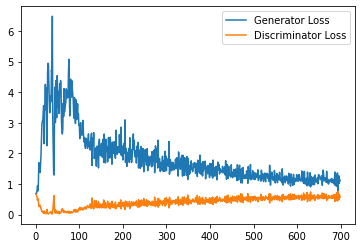

Step 14500: Generator loss: 1.081730762720108, Discriminator's loss: 0.5782253088355065


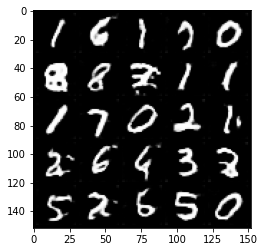

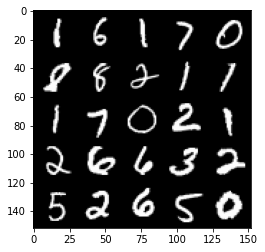

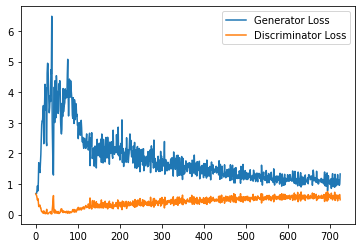

Step 15000: Generator loss: 1.0712370283603667, Discriminator's loss: 0.5847136783003807


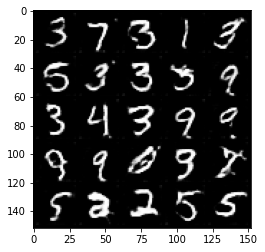

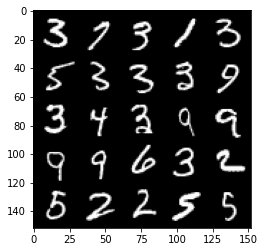

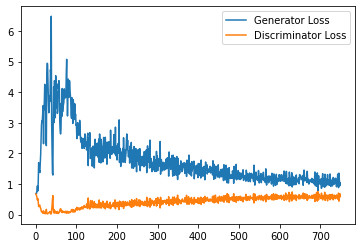

Step 15500: Generator loss: 1.0646425582170487, Discriminator's loss: 0.5817632063627243


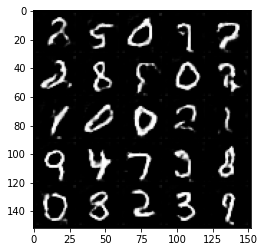

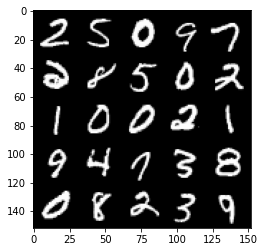

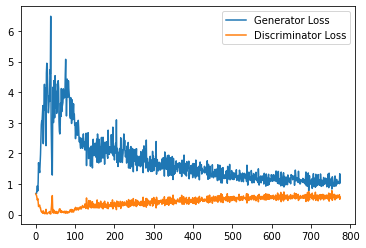

Step 16000: Generator loss: 1.0722474657297134, Discriminator's loss: 0.5811197035312653


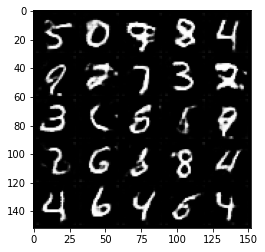

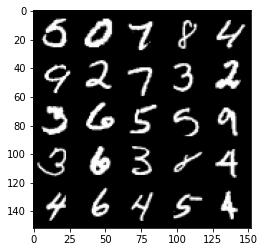

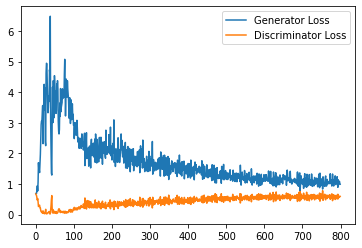

Step 16500: Generator loss: 1.063794887304306, Discriminator's loss: 0.5863332069516182


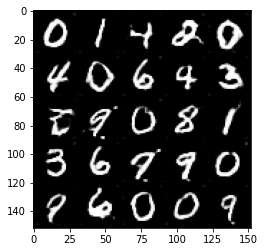

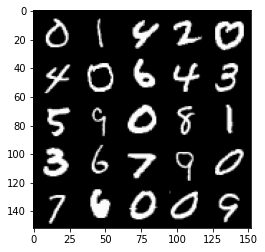

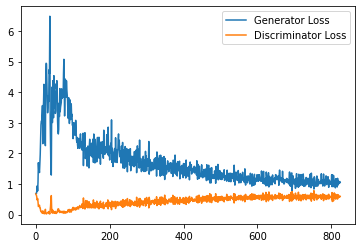

Step 17000: Generator loss: 1.058045101761818, Discriminator's loss: 0.5897881000041961


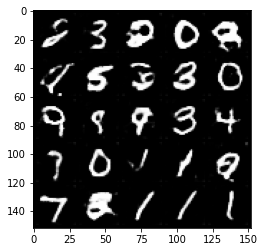

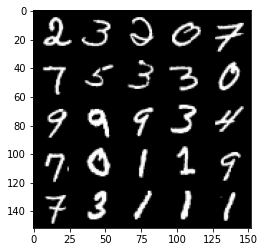

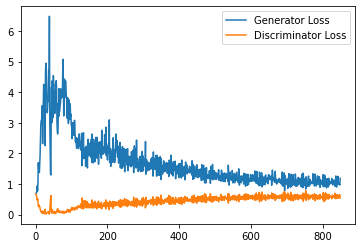

Step 17500: Generator loss: 1.056990104317665, Discriminator's loss: 0.5949401478767395


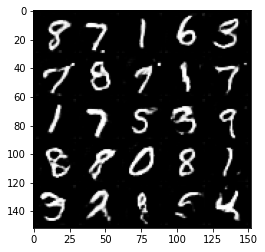

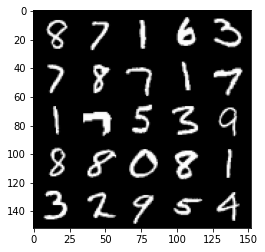

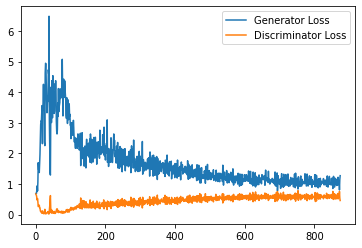

Step 18000: Generator loss: 1.039857216000557, Discriminator's loss: 0.5979924852252007


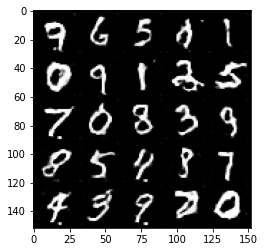

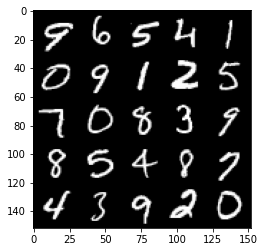

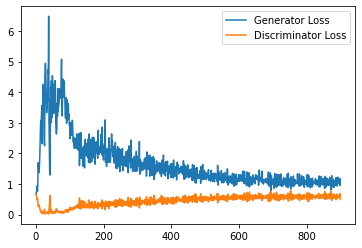

Step 18500: Generator loss: 1.01707122528553, Discriminator's loss: 0.5992095673084259


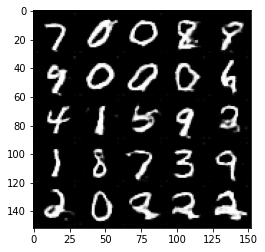

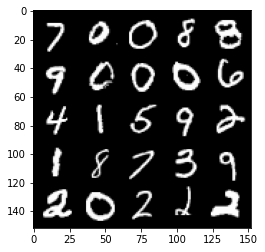

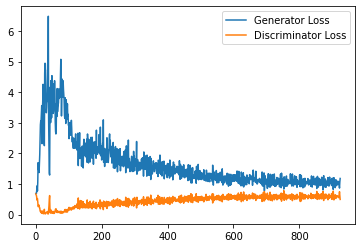

Step 19000: Generator loss: 1.0141957848072052, Discriminator's loss: 0.6022344787716866


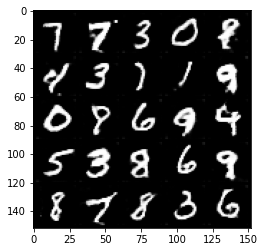

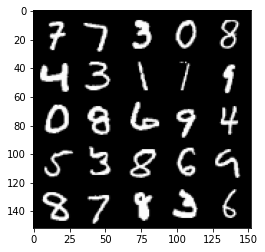

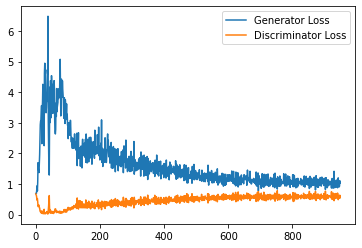

Step 19500: Generator loss: 1.0108330627679825, Discriminator's loss: 0.5949039462208748


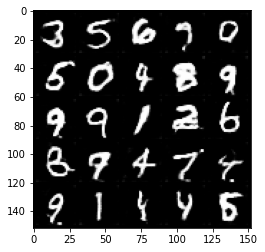

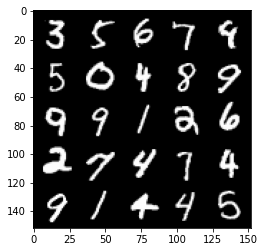

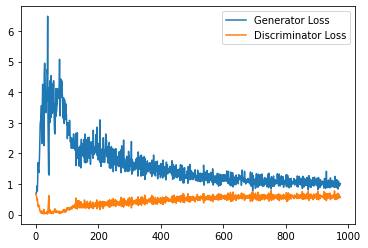

Step 20000: Generator loss: 1.0152221060991287, Discriminator's loss: 0.6052384486794472


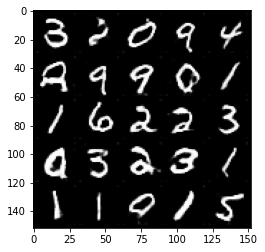

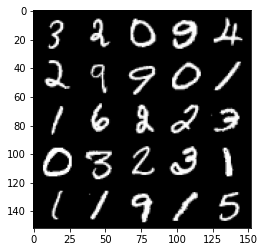

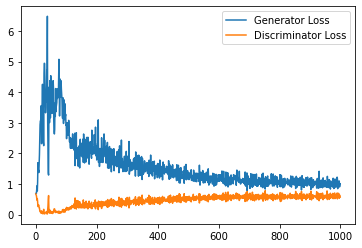

Step 20500: Generator loss: 0.9822311857938767, Discriminator's loss: 0.610682549059391


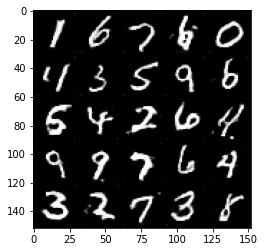

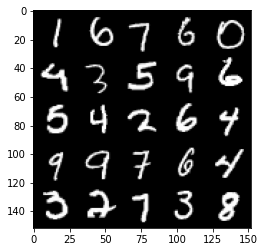

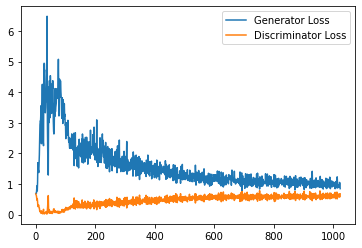

Step 21000: Generator loss: 0.9926195505857468, Discriminator's loss: 0.60153355717659


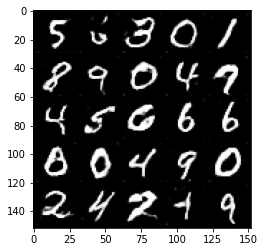

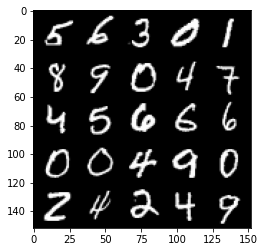

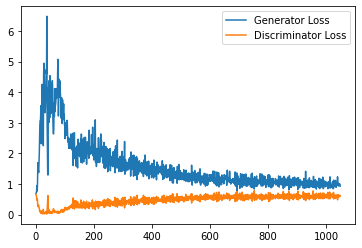

Step 21500: Generator loss: 1.001252297759056, Discriminator's loss: 0.6123694282770157


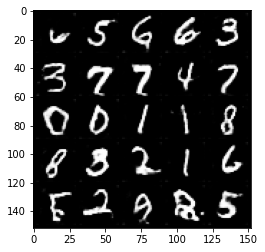

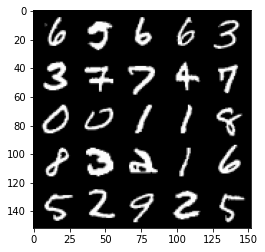

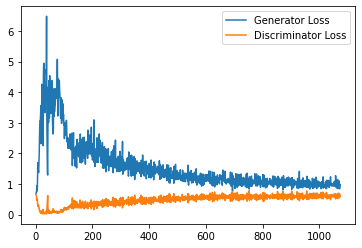

Step 22000: Generator loss: 0.9781125596761704, Discriminator's loss: 0.6102698810696602


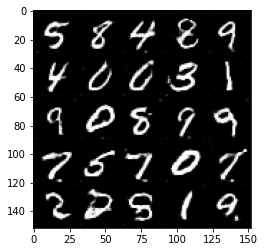

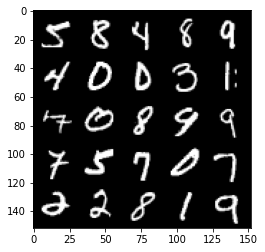

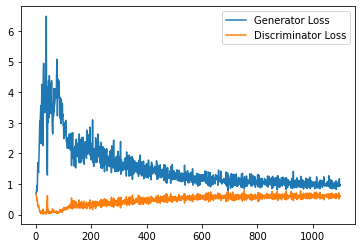

Step 22500: Generator loss: 0.9744682846069336, Discriminator's loss: 0.6049458502531052


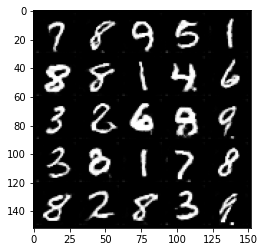

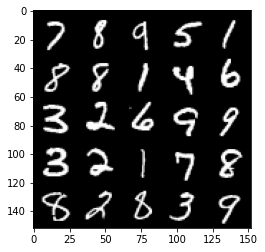

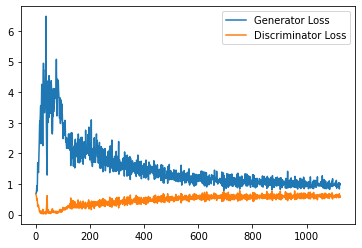

Step 23000: Generator loss: 0.9802672287225723, Discriminator's loss: 0.6081134009361268


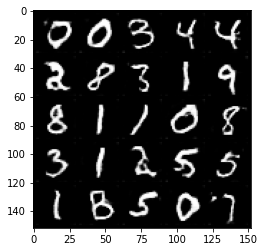

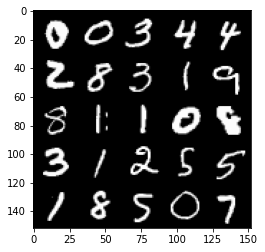

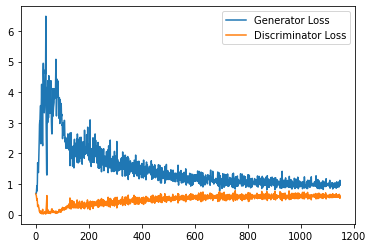

Step 23500: Generator loss: 0.9921674828529358, Discriminator's loss: 0.610801477432251


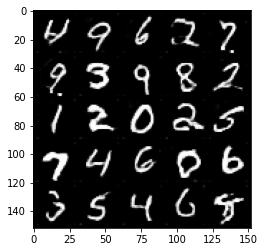

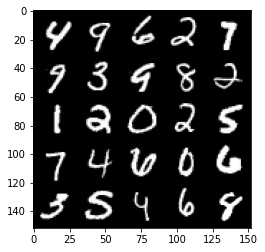

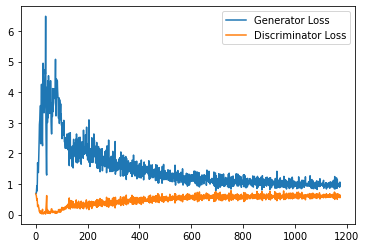

Step 24000: Generator loss: 0.970243000626564, Discriminator's loss: 0.6150067321658135


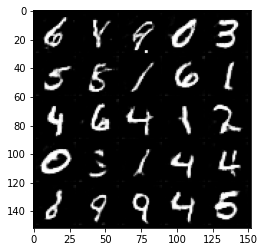

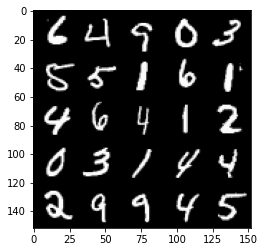

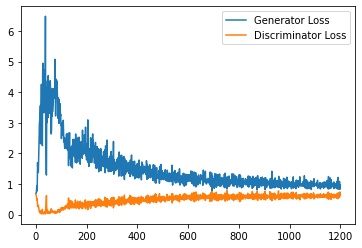

Step 24500: Generator loss: 0.9973283632993698, Discriminator's loss: 0.6150541315674782


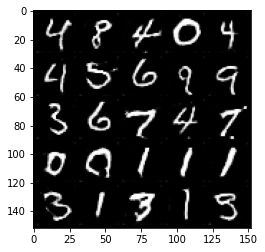

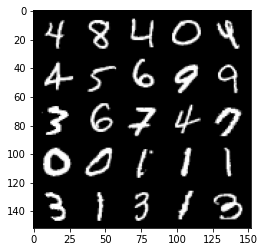

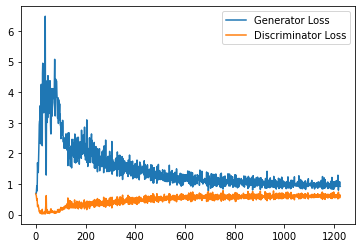

Step 25000: Generator loss: 0.9948204271793365, Discriminator's loss: 0.6150733705163002


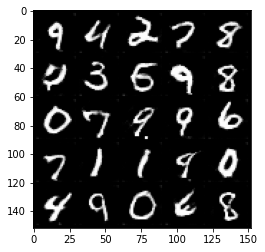

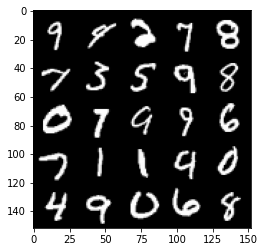

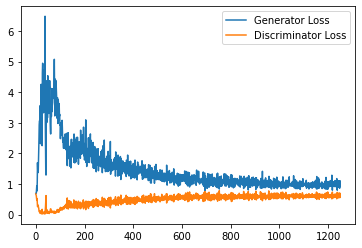

Step 25500: Generator loss: 0.9905257873535156, Discriminator's loss: 0.6084915400147438


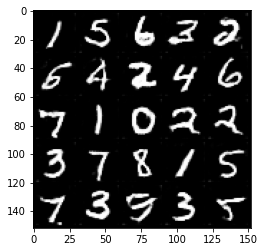

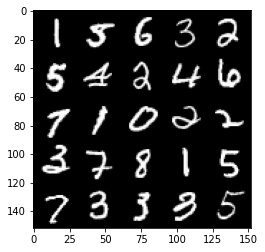

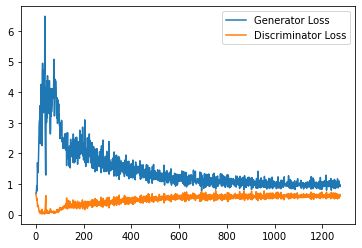

Step 26000: Generator loss: 0.9664781445264816, Discriminator's loss: 0.6082198311686515


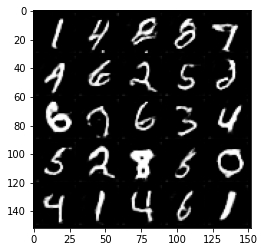

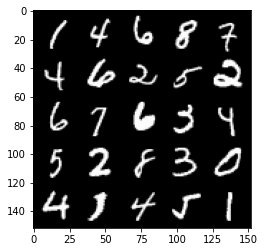

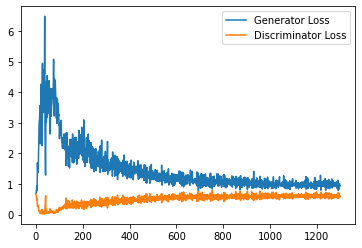

Step 26500: Generator loss: 0.9634717239141464, Discriminator's loss: 0.6168043814897537


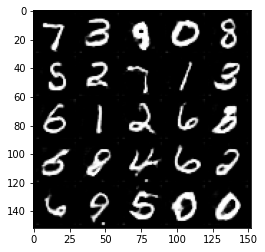

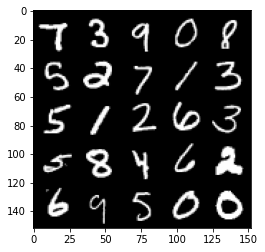

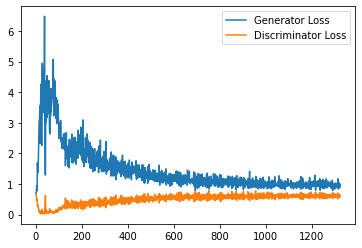

Step 27000: Generator loss: 0.9651101889610291, Discriminator's loss: 0.6227569902539253


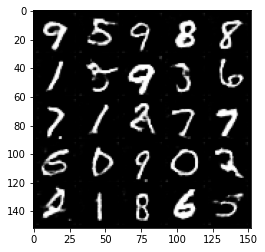

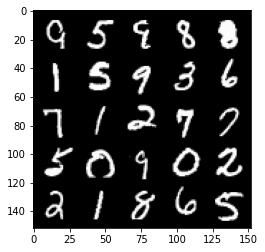

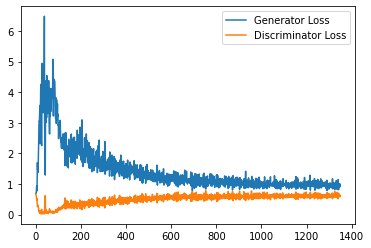

Step 27500: Generator loss: 0.9465220863819123, Discriminator's loss: 0.6172214055657387


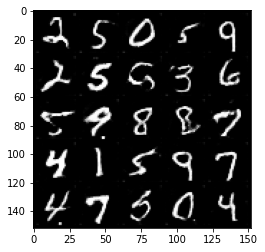

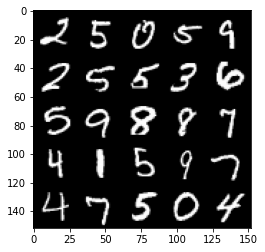

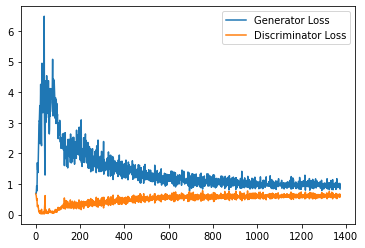

Step 28000: Generator loss: 0.9486416683197022, Discriminator's loss: 0.6181233790516854


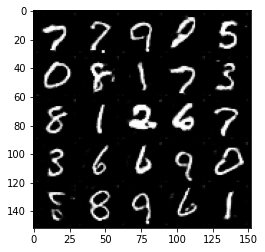

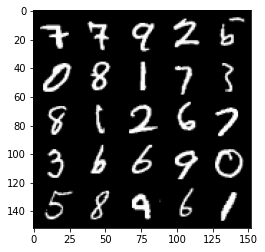

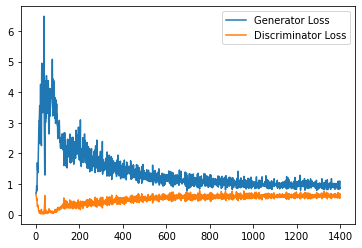

Step 28500: Generator loss: 0.9445926851034164, Discriminator's loss: 0.6154501951932907


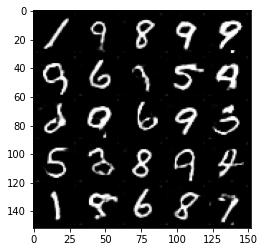

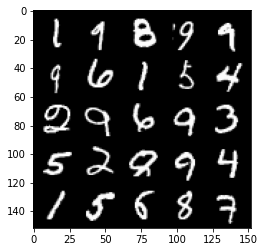

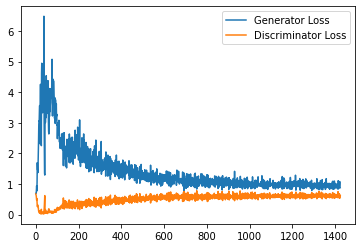

Step 29000: Generator loss: 0.9671081521511078, Discriminator's loss: 0.6169091465473175


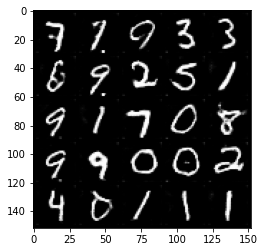

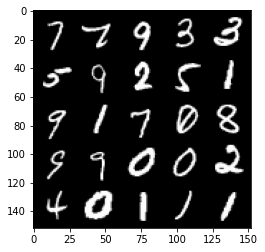

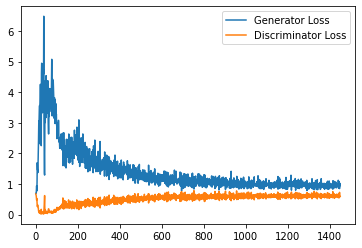

Step 29500: Generator loss: 0.9457176192998886, Discriminator's loss: 0.6189404944181442


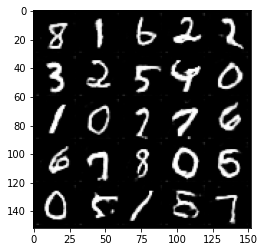

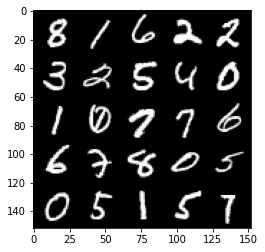

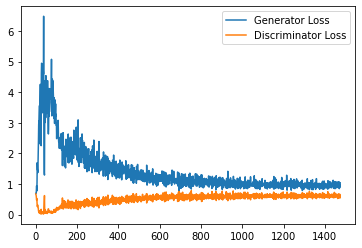

Step 30000: Generator loss: 0.9281520813703537, Discriminator's loss: 0.6199448999762535


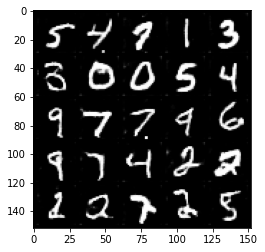

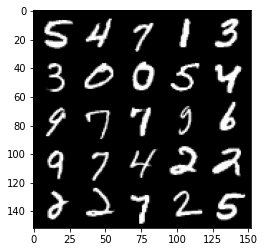

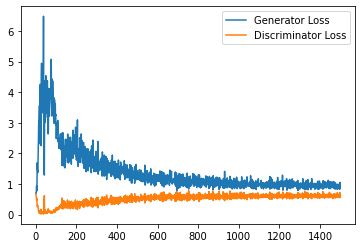

Step 30500: Generator loss: 0.929653235077858, Discriminator's loss: 0.624615157365799


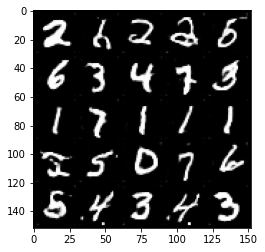

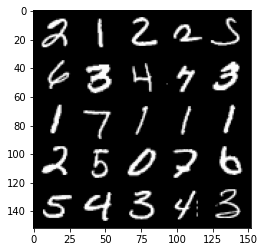

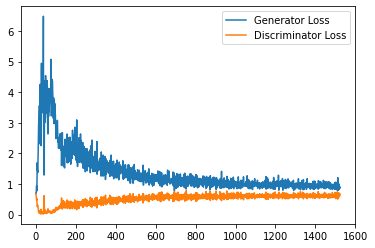

Step 31000: Generator loss: 0.9547132186889649, Discriminator's loss: 0.6140101918578148


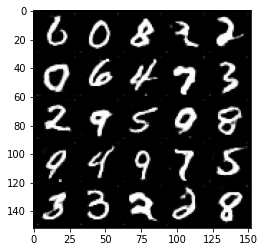

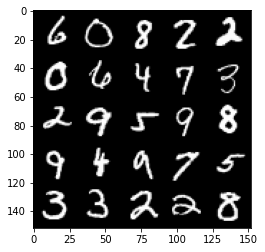

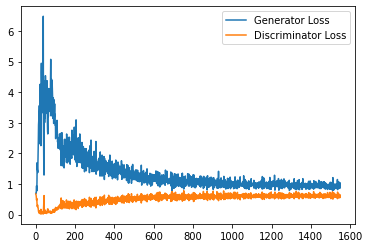

Step 31500: Generator loss: 0.9275177314281463, Discriminator's loss: 0.6259144271612167


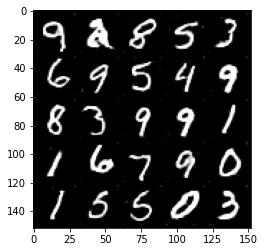

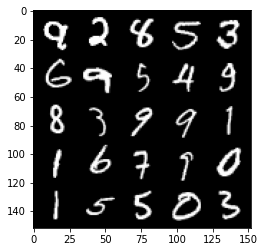

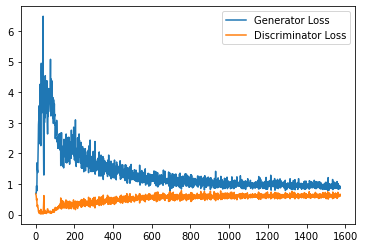

Step 32000: Generator loss: 0.9274300357103348, Discriminator's loss: 0.6199363723397255


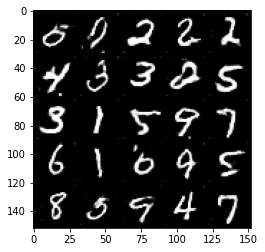

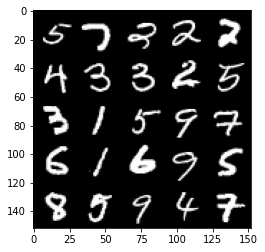

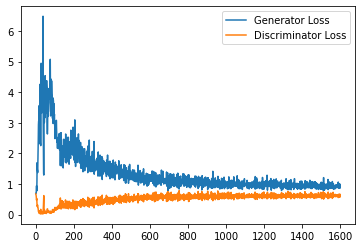

Step 32500: Generator loss: 0.9217963380813599, Discriminator's loss: 0.6222836724519729


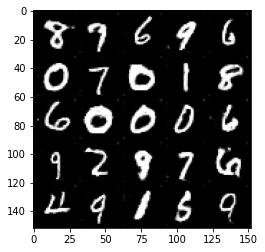

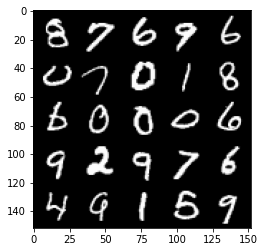

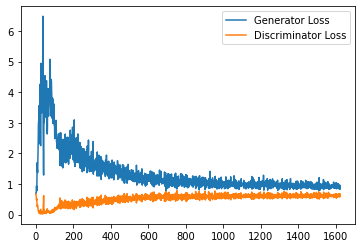

Step 33000: Generator loss: 0.9284130066633225, Discriminator's loss: 0.6214513235092163


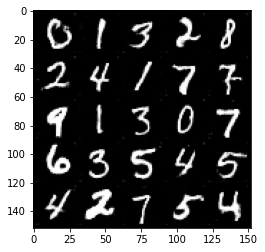

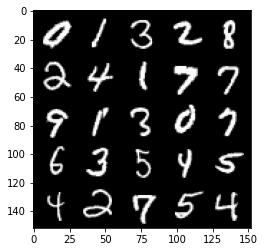

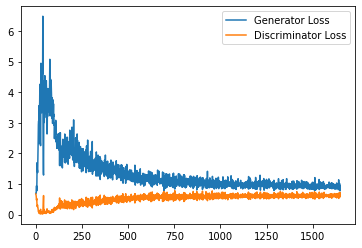

Step 33500: Generator loss: 0.923555738210678, Discriminator's loss: 0.6288997620940209


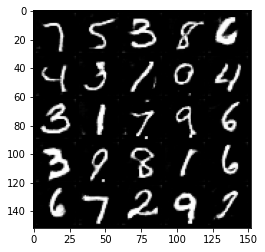

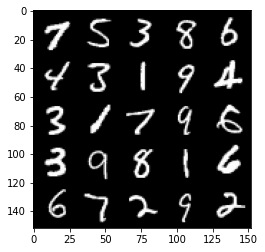

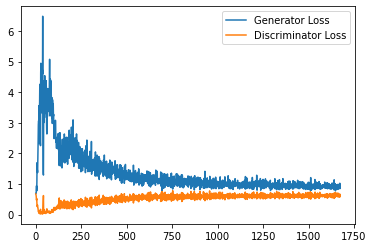

Step 34000: Generator loss: 0.9423552411794662, Discriminator's loss: 0.6207993889451027


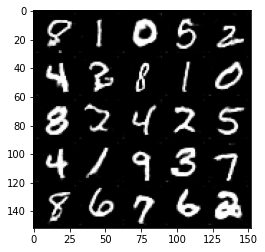

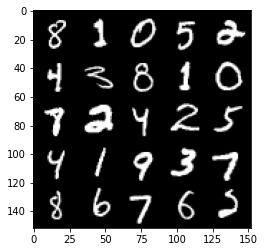

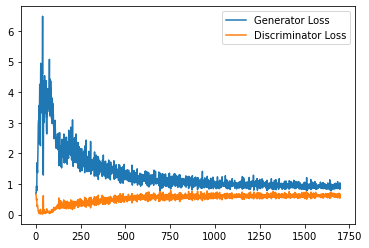

Step 34500: Generator loss: 0.9271824648380279, Discriminator's loss: 0.6281207337975502


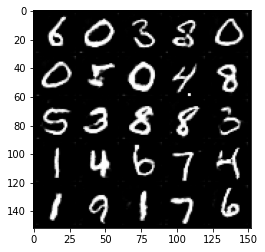

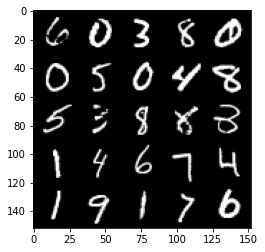

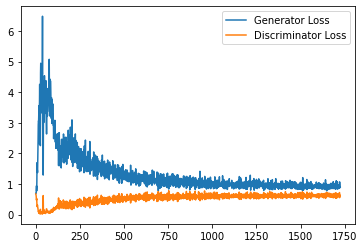

Step 35000: Generator loss: 0.9321636080741882, Discriminator's loss: 0.6199021879434585


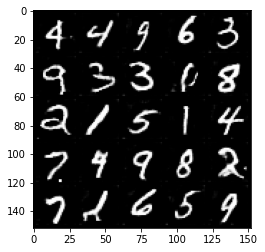

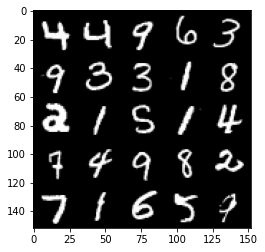

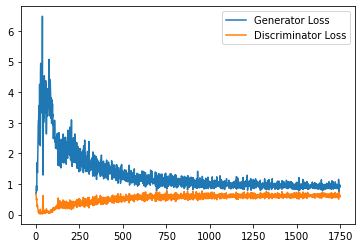

Step 35500: Generator loss: 0.9319507267475128, Discriminator's loss: 0.6286476686000824


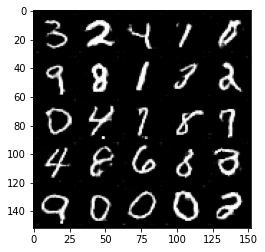

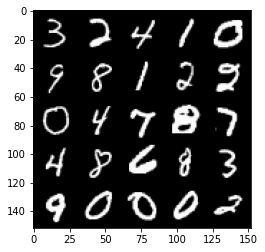

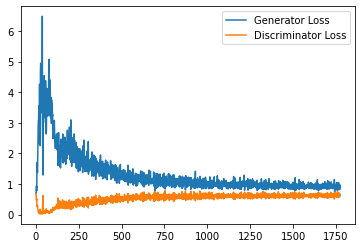

Step 36000: Generator loss: 0.9178237051963806, Discriminator's loss: 0.6262472466826439


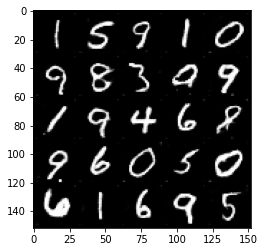

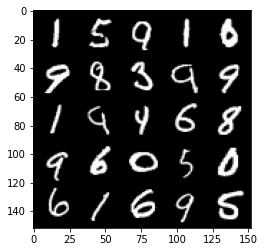

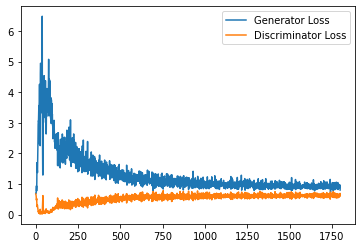

Step 36500: Generator loss: 0.9402338200807572, Discriminator's loss: 0.6213719208240509


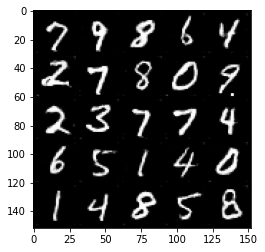

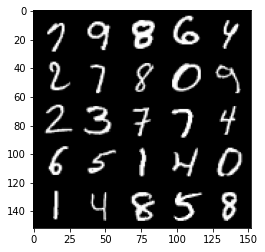

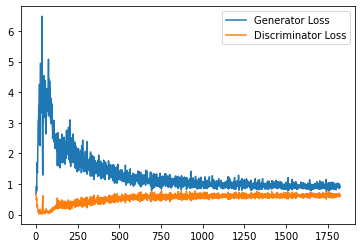

Step 37000: Generator loss: 0.9486804029941559, Discriminator's loss: 0.6243028647303581


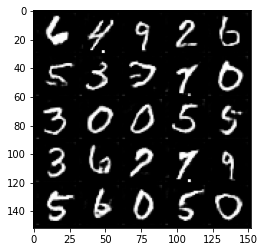

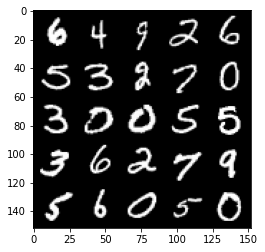

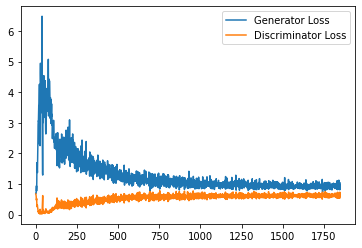

Step 37500: Generator loss: 0.9355055780410767, Discriminator's loss: 0.6279574513435364


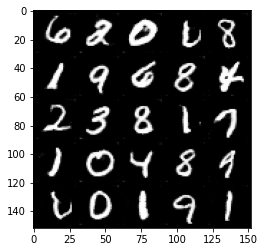

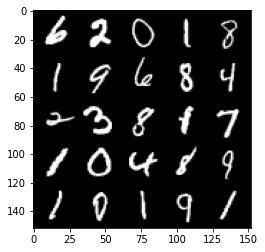

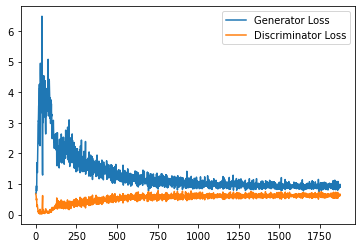

Step 38000: Generator loss: 0.9191851223707199, Discriminator's loss: 0.6242774674892425


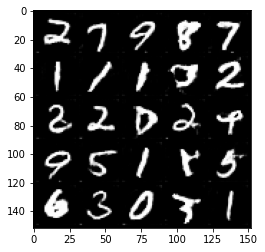

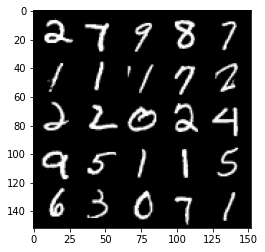

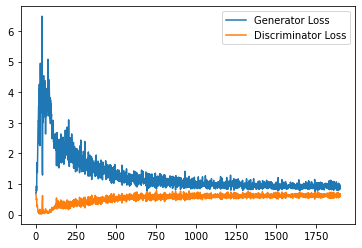

Step 38500: Generator loss: 0.9259574310779571, Discriminator's loss: 0.6215887817144394


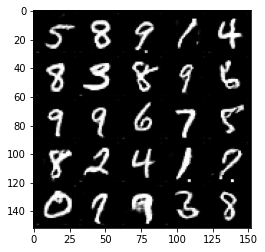

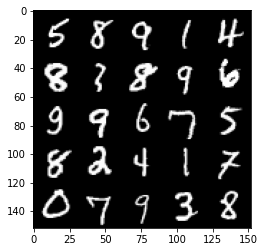

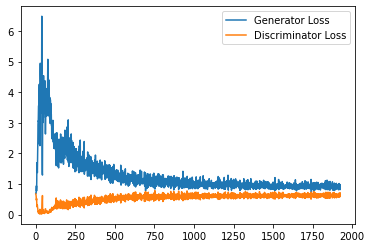

Step 39000: Generator loss: 0.9348205146789551, Discriminator's loss: 0.6260919729471207


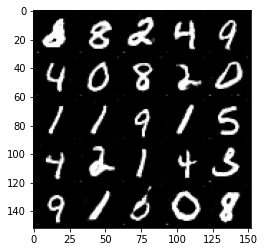

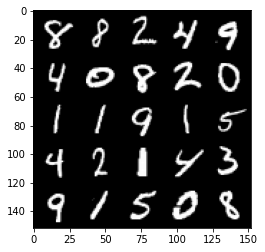

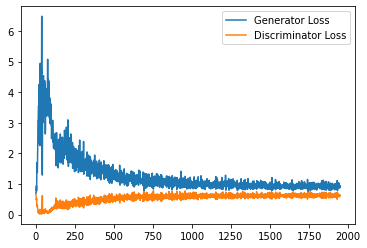

Step 39500: Generator loss: 0.93756194627285, Discriminator's loss: 0.6284710918664932


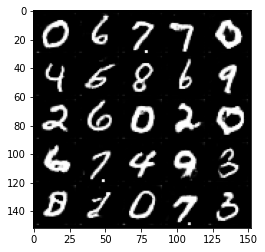

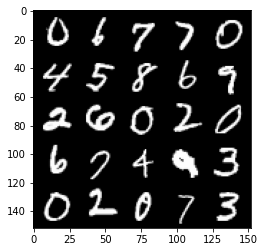

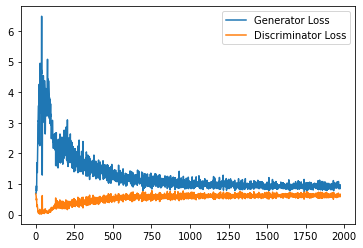

Step 40000: Generator loss: 0.902744947552681, Discriminator's loss: 0.625675178527832


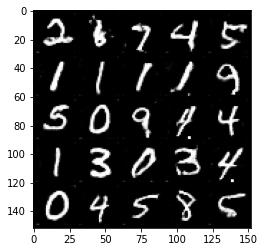

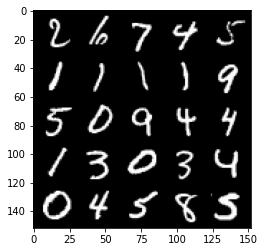

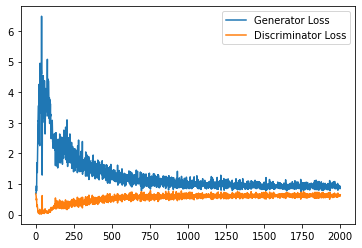

Step 40500: Generator loss: 0.9296535454988479, Discriminator's loss: 0.6205590561032295


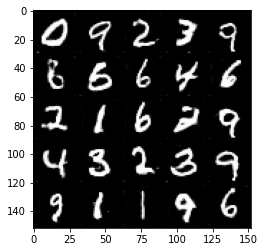

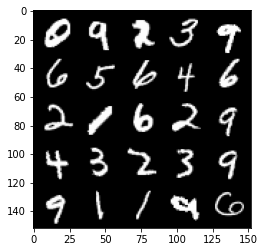

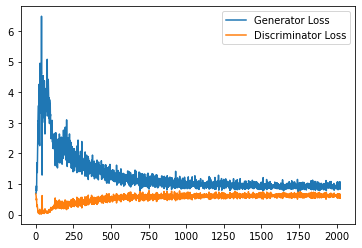

Step 41000: Generator loss: 0.9160486340522767, Discriminator's loss: 0.6304990827441216


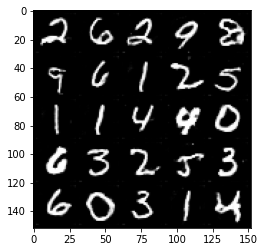

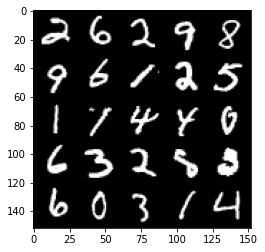

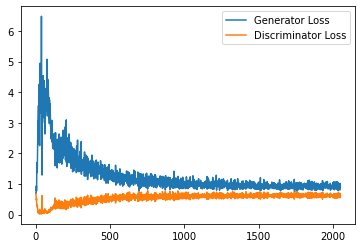

Step 41500: Generator loss: 0.9201199333667756, Discriminator's loss: 0.6221519436836243


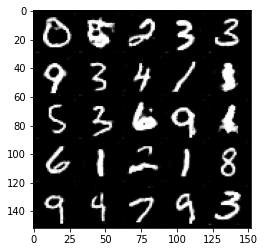

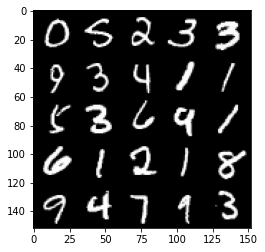

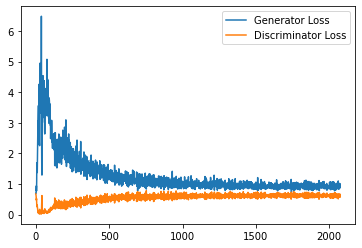

Step 42000: Generator loss: 0.9365709333419799, Discriminator's loss: 0.6221046174764633


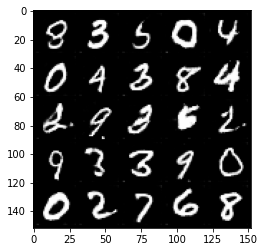

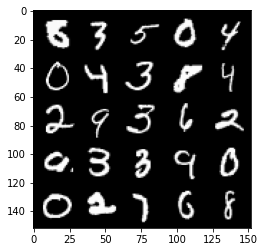

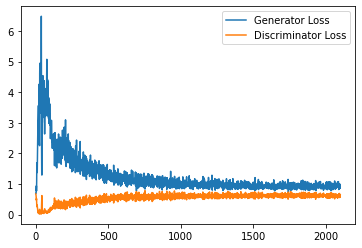

Step 42500: Generator loss: 0.9190860923528671, Discriminator's loss: 0.6198860166668891


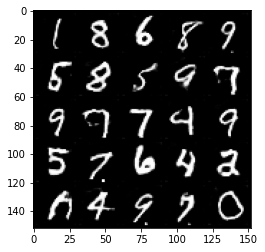

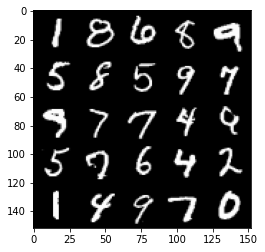

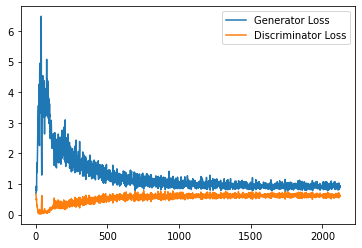

Step 43000: Generator loss: 0.9171809058189392, Discriminator's loss: 0.6257861190438271


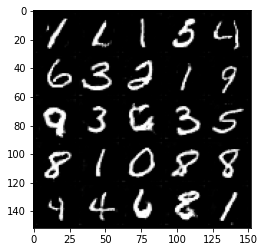

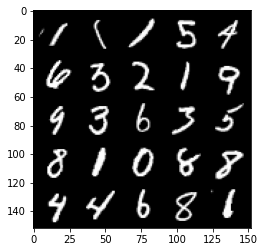

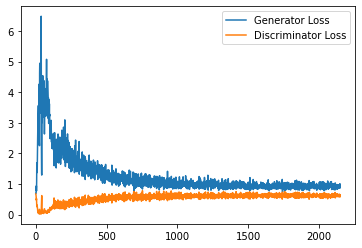

Step 43500: Generator loss: 0.9445611635446548, Discriminator's loss: 0.6256321188211441


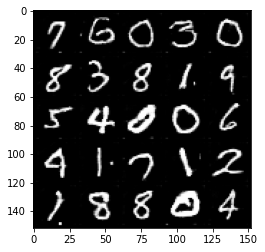

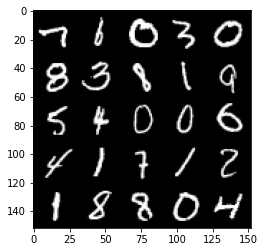

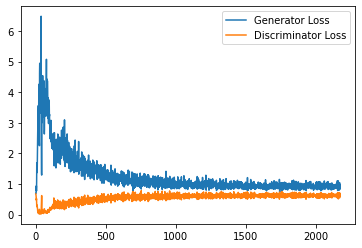

Step 44000: Generator loss: 0.9268760676383972, Discriminator's loss: 0.6209768042564392


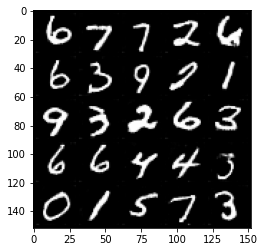

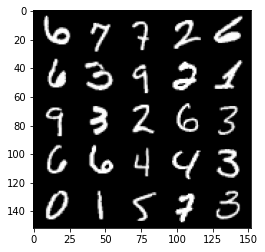

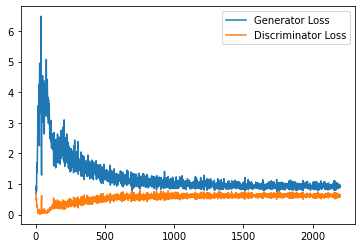

Step 44500: Generator loss: 0.921556931734085, Discriminator's loss: 0.6224728214144707


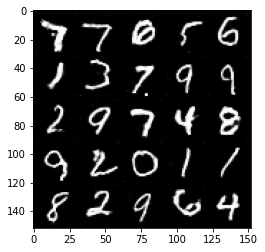

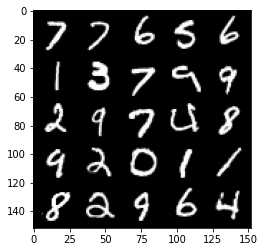

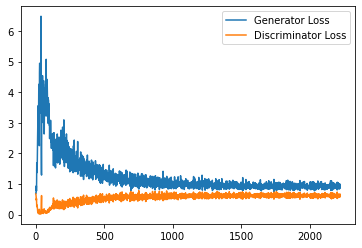

Step 45000: Generator loss: 0.9138933324813843, Discriminator's loss: 0.6239531832337379


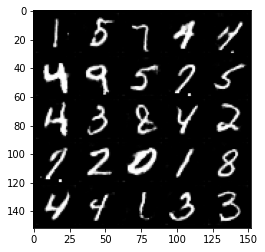

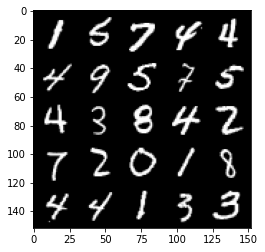

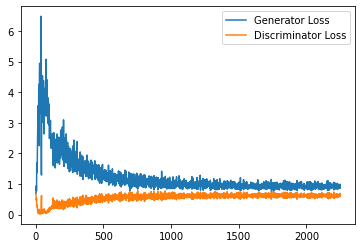

Step 45500: Generator loss: 0.9151791471242905, Discriminator's loss: 0.6253265851140022


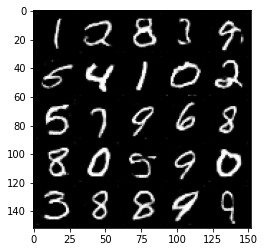

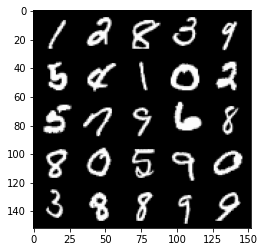

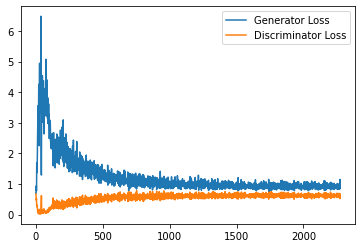

Step 46000: Generator loss: 0.9099612421989441, Discriminator's loss: 0.627316115796566


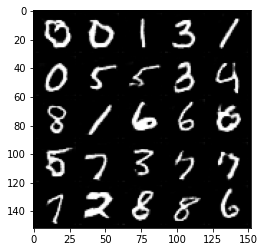

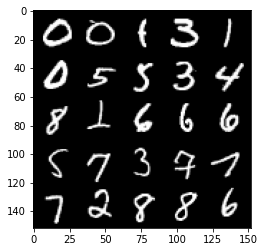

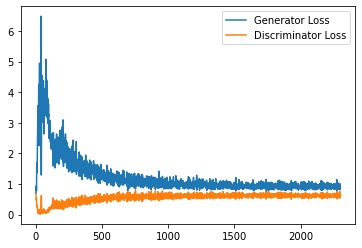

Step 46500: Generator loss: 0.9064675374031067, Discriminator's loss: 0.6288737369775772


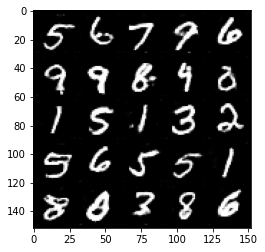

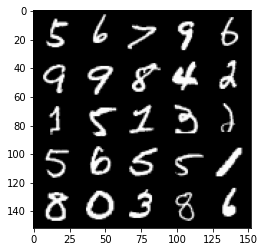

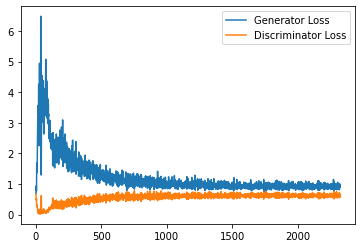

Step 47000: Generator loss: 0.9420479884147644, Discriminator's loss: 0.6195264735817909


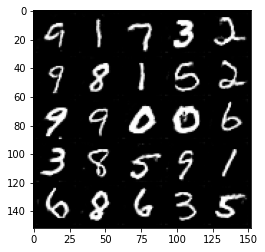

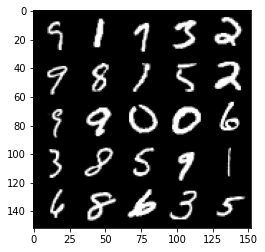

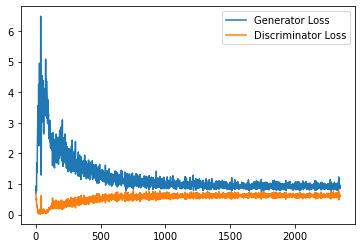

Step 47500: Generator loss: 0.9370648316144943, Discriminator's loss: 0.6292260292768478


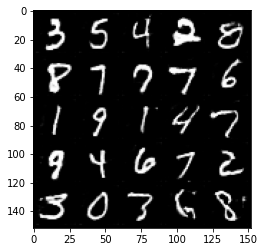

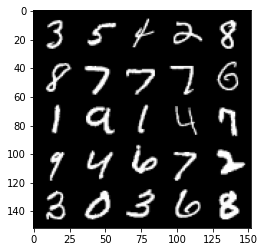

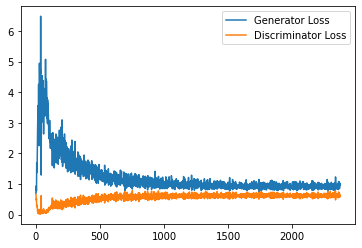

Step 48000: Generator loss: 0.912429490327835, Discriminator's loss: 0.6329146050214768


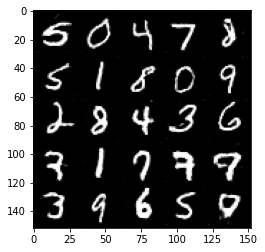

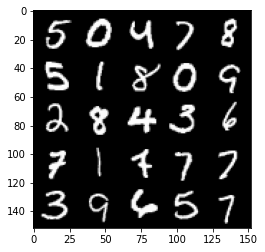

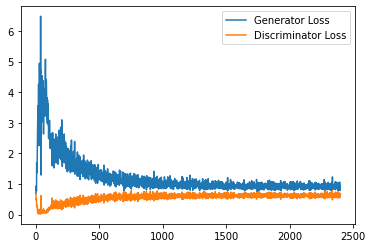

Step 48500: Generator loss: 0.9169848792552948, Discriminator's loss: 0.6212994309663773


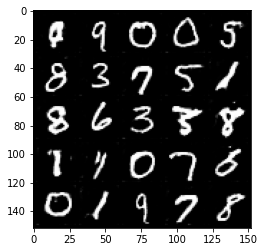

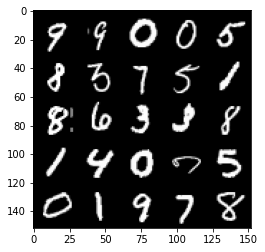

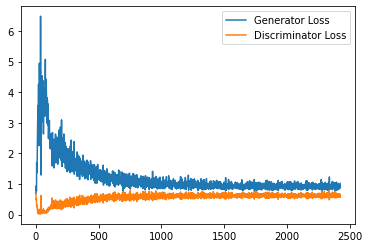

Step 49000: Generator loss: 0.9386393629312515, Discriminator's loss: 0.6262374023795128


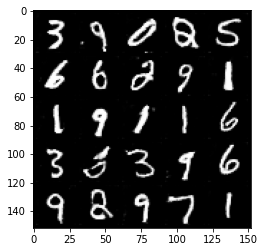

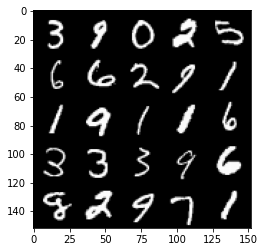

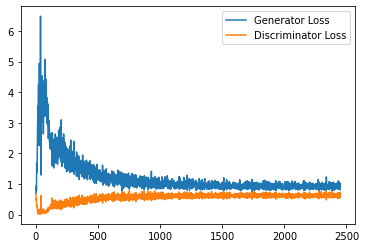

Step 49500: Generator loss: 0.8985243388414383, Discriminator's loss: 0.6301739892363548


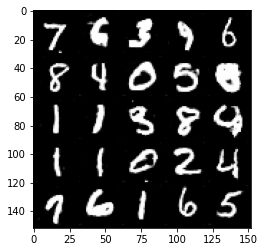

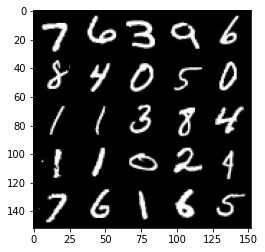

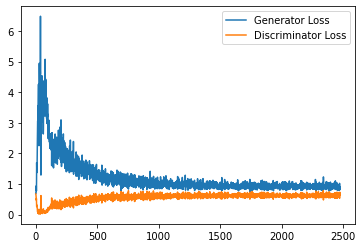

Step 50000: Generator loss: 0.9103509032726288, Discriminator's loss: 0.627568158864975


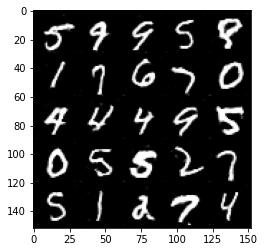

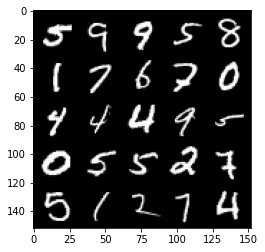

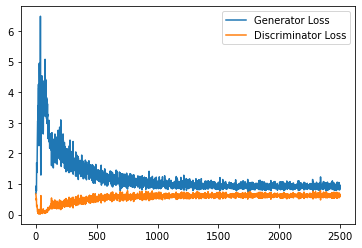

Step 50500: Generator loss: 0.9157290548086167, Discriminator's loss: 0.6256707659959793


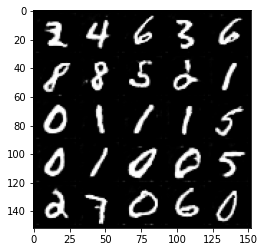

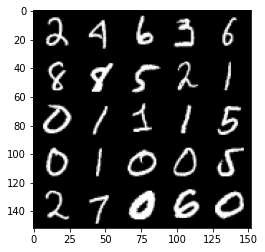

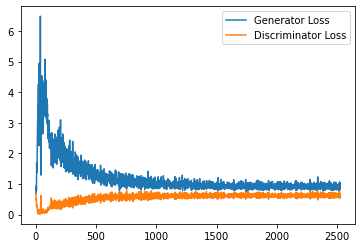

Step 51000: Generator loss: 0.9178291593790054, Discriminator's loss: 0.623183445096016


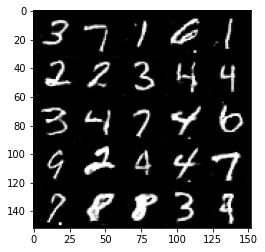

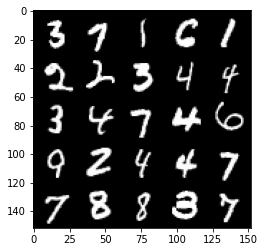

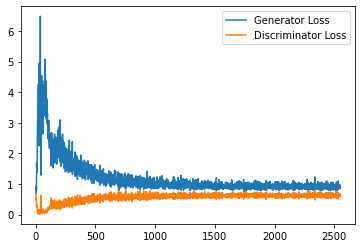

Step 51500: Generator loss: 0.936736459851265, Discriminator's loss: 0.622616753935814


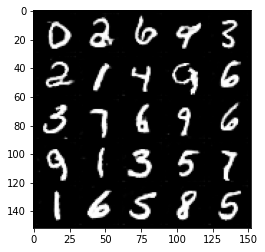

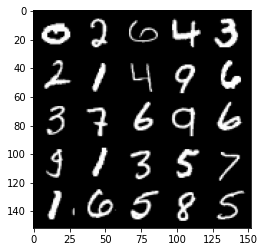

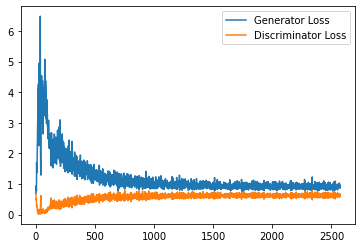

Step 52000: Generator loss: 0.9137876721620559, Discriminator's loss: 0.6287943094372749


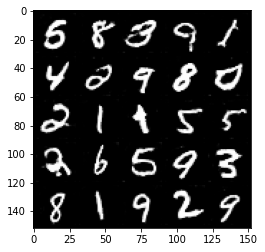

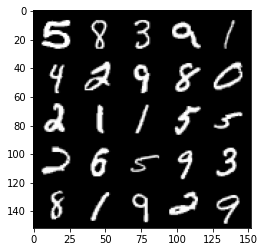

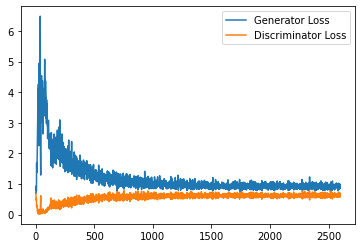

Step 52500: Generator loss: 0.920151378273964, Discriminator's loss: 0.6195683002471923


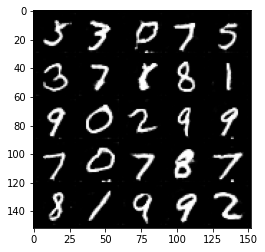

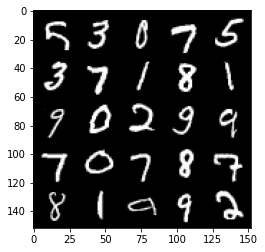

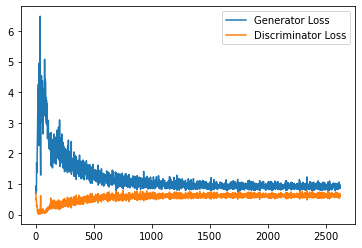

Step 53000: Generator loss: 0.9205728036165237, Discriminator's loss: 0.6264719761013985


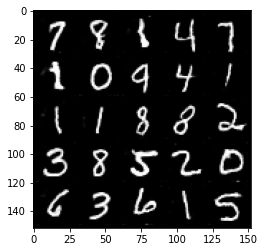

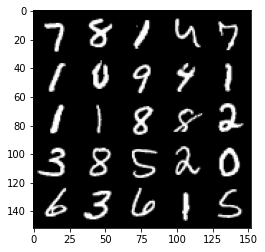

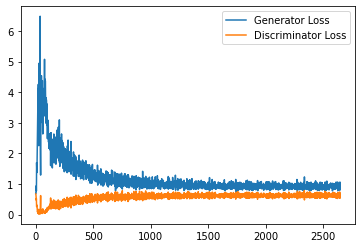

Step 53500: Generator loss: 0.9200850384235382, Discriminator's loss: 0.6227134755849838


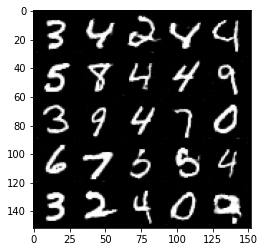

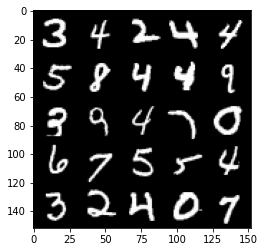

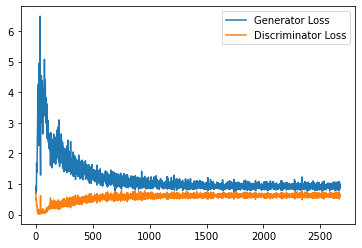

Step 54000: Generator loss: 0.9240134587287903, Discriminator's loss: 0.6190794445872306


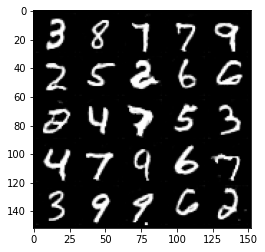

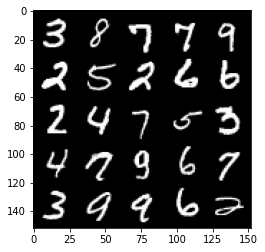

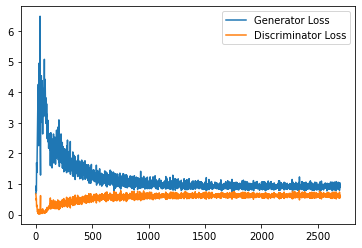

Step 54500: Generator loss: 0.9141129810810089, Discriminator's loss: 0.6225500147342682


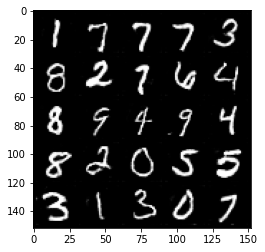

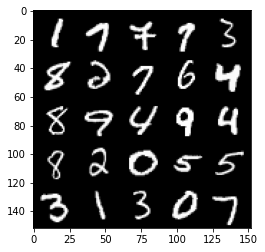

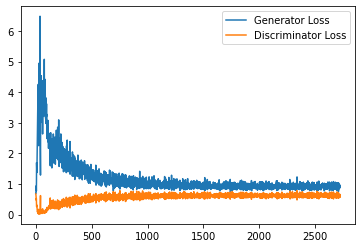

Step 55000: Generator loss: 0.9347819658517837, Discriminator's loss: 0.6175181338787079


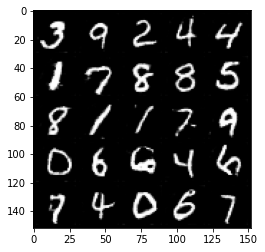

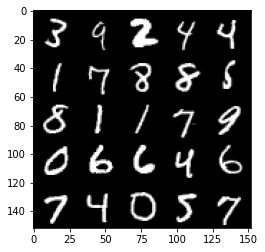

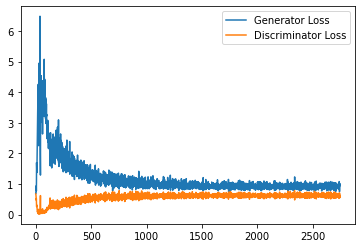

Step 55500: Generator loss: 0.9309071129560471, Discriminator's loss: 0.6232353712916374


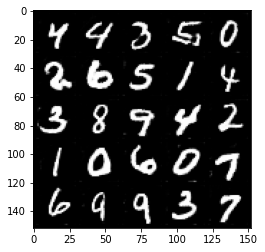

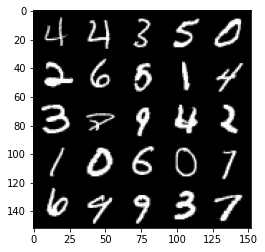

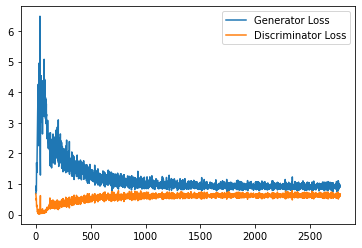

Step 56000: Generator loss: 0.9245503543615341, Discriminator's loss: 0.6193240772485733


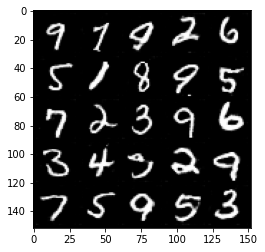

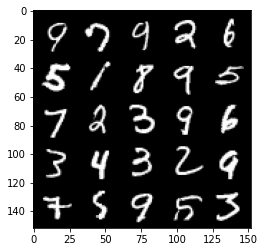

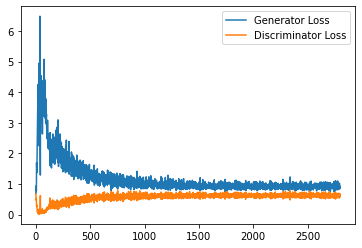

Step 56500: Generator loss: 0.9298044677972793, Discriminator's loss: 0.62265663677454


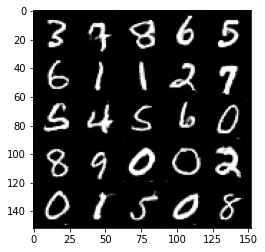

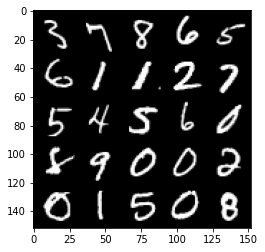

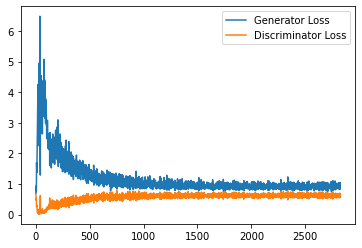

Step 57000: Generator loss: 0.9372530785799027, Discriminator's loss: 0.6222924919724464


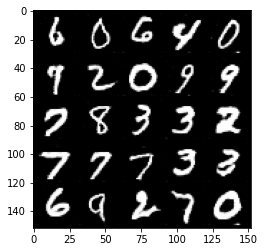

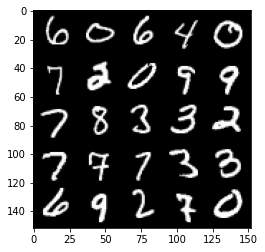

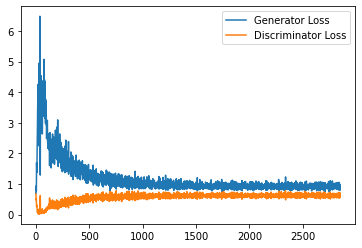

Step 57500: Generator loss: 0.9266976004838944, Discriminator's loss: 0.6191462849974633


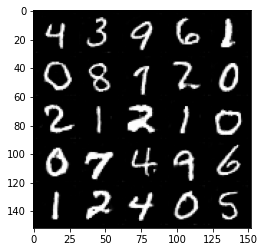

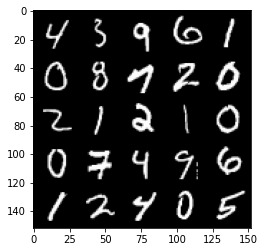

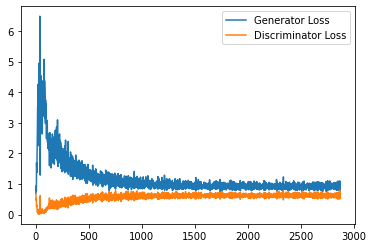

Step 58000: Generator loss: 0.9464688606262207, Discriminator's loss: 0.6118329067230225


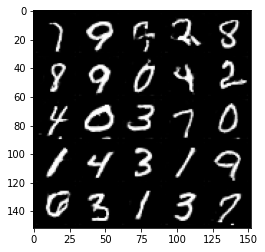

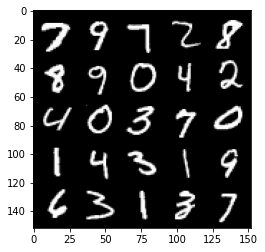

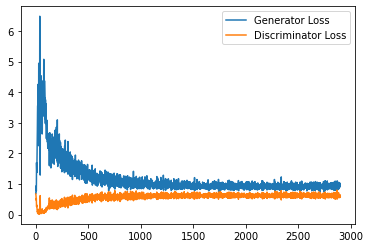

Step 58500: Generator loss: 0.9323657504320144, Discriminator's loss: 0.6195188062191009


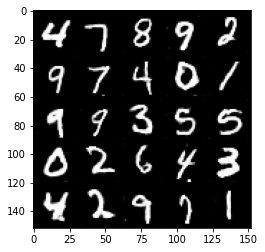

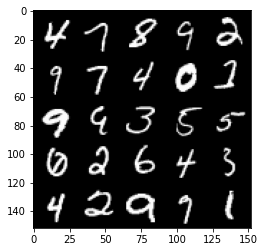

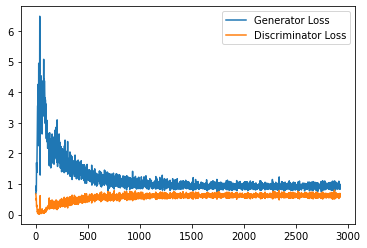

Step 59000: Generator loss: 0.9328508307933807, Discriminator's loss: 0.6161467408537865


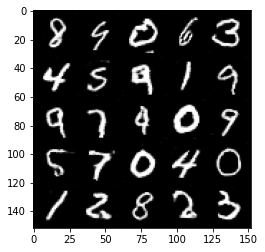

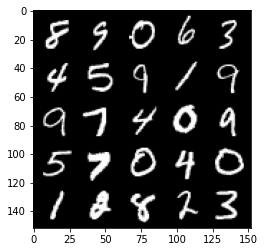

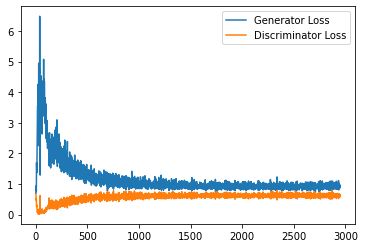

Step 59500: Generator loss: 0.9458791408538818, Discriminator's loss: 0.6144085559248924


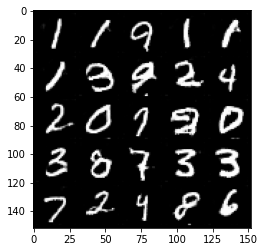

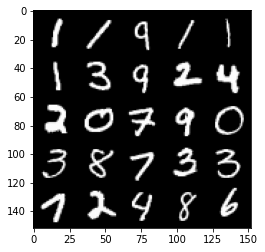

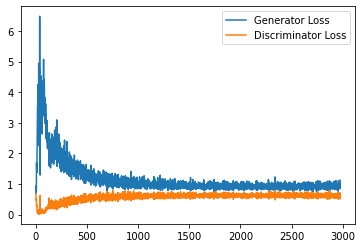

Step 60000: Generator loss: 0.9371867741346359, Discriminator's loss: 0.6206965753436089


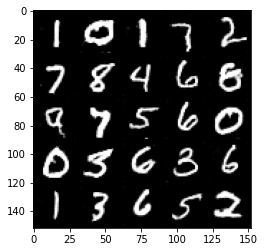

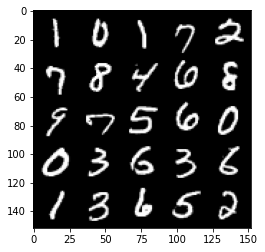

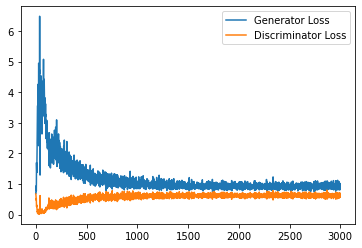

Step 60500: Generator loss: 0.9278354562520981, Discriminator's loss: 0.6151965112090111


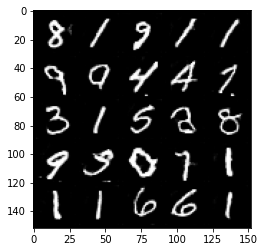

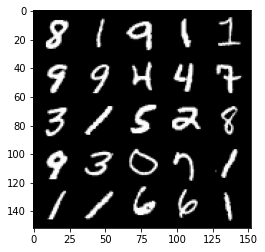

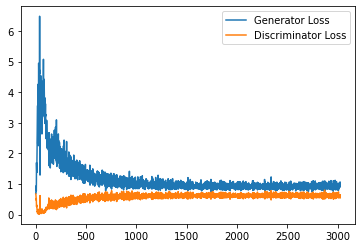

Step 61000: Generator loss: 0.9273077330589294, Discriminator's loss: 0.622744788825512


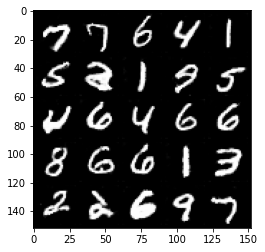

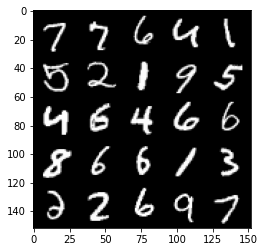

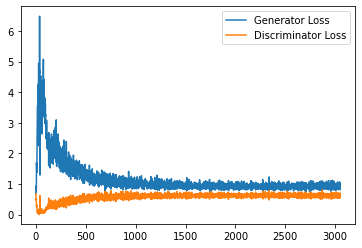

Step 61500: Generator loss: 0.945202742934227, Discriminator's loss: 0.613369463801384


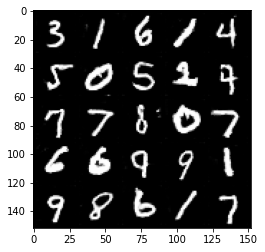

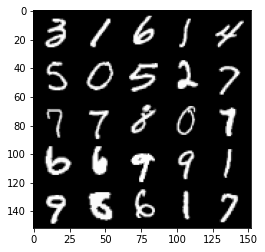

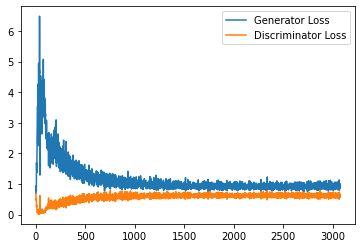

Step 62000: Generator loss: 0.9383288186788559, Discriminator's loss: 0.6103867872357368


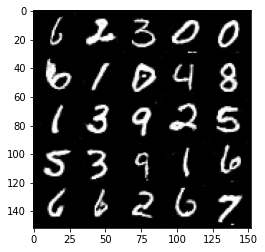

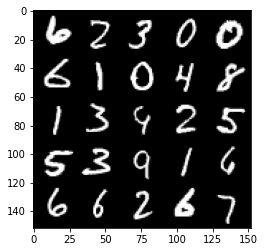

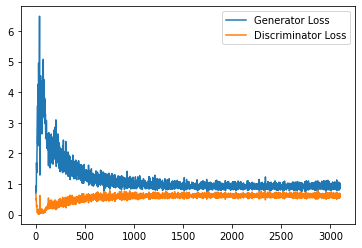

Step 62500: Generator loss: 0.9311327313184738, Discriminator's loss: 0.612227180659771


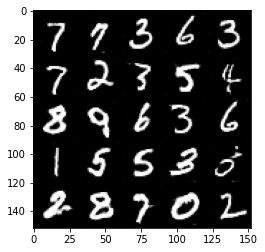

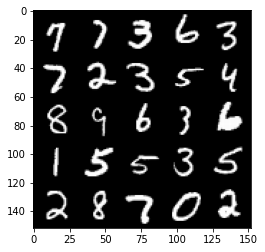

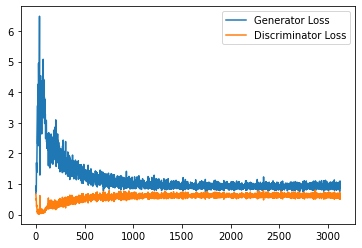

Step 63000: Generator loss: 0.9417300887107849, Discriminator's loss: 0.6192384498715401


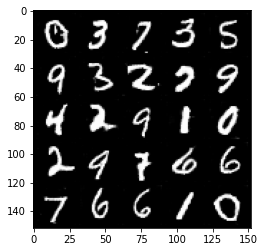

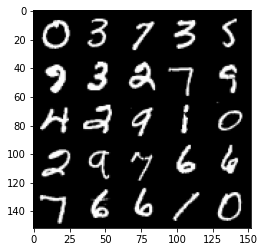

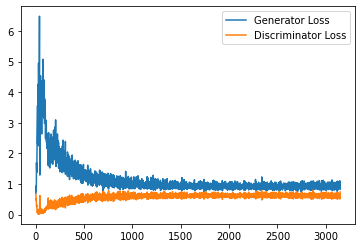

Step 63500: Generator loss: 0.9537501821517944, Discriminator's loss: 0.6081615162491798


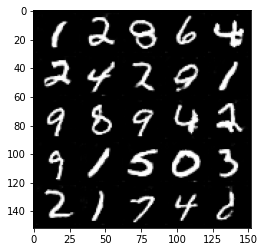

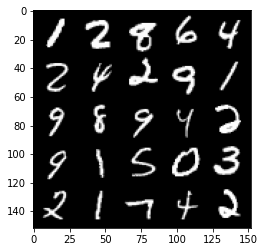

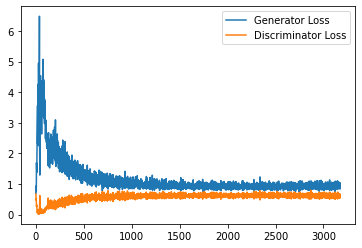

Step 64000: Generator loss: 0.9232043075561523, Discriminator's loss: 0.6117121097445488


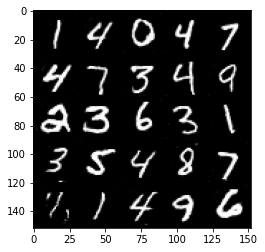

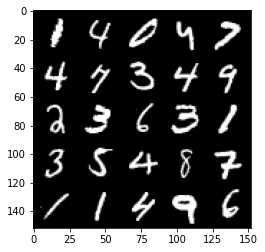

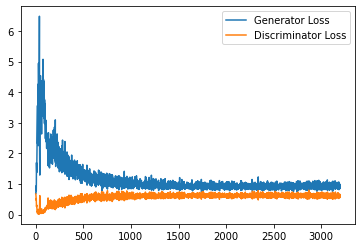

Step 64500: Generator loss: 0.9429209024906159, Discriminator's loss: 0.6132354529500008


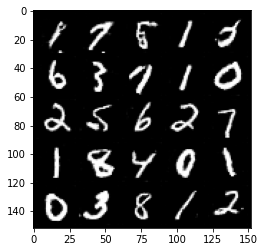

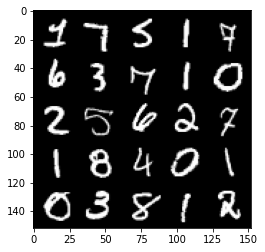

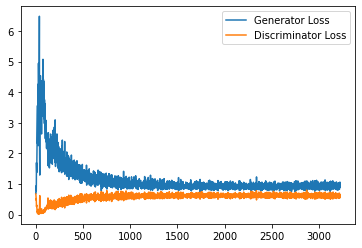

Step 65000: Generator loss: 0.9491816242933273, Discriminator's loss: 0.6159417849183083


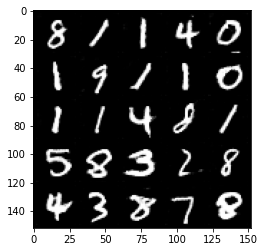

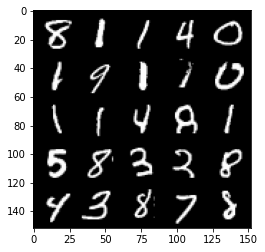

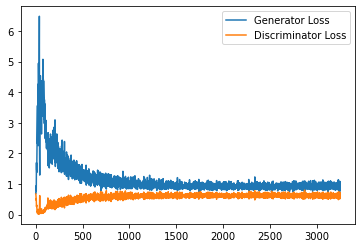

Step 65500: Generator loss: 0.9496179087162018, Discriminator's loss: 0.6142745549678803


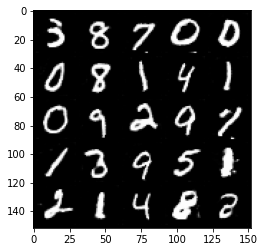

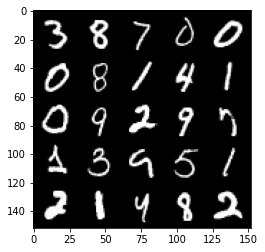

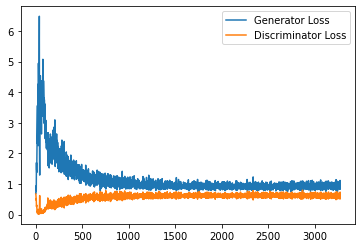

Step 66000: Generator loss: 0.9496052017211914, Discriminator's loss: 0.6105540004372597


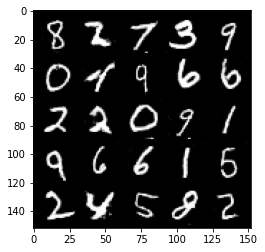

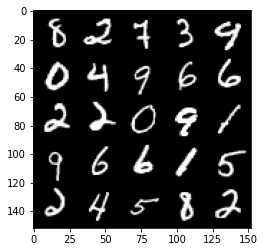

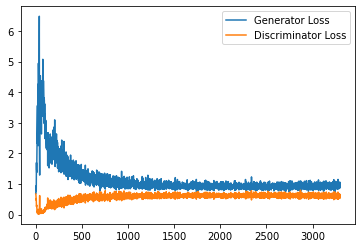

Step 66500: Generator loss: 0.9414885315895081, Discriminator's loss: 0.6084748930931091


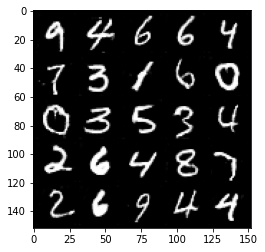

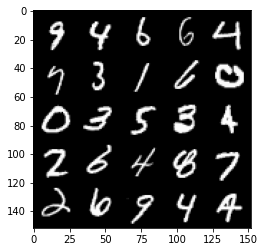

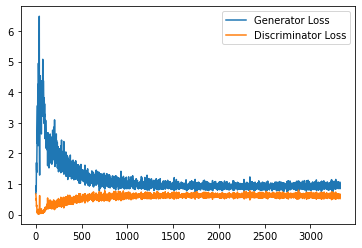

Step 67000: Generator loss: 0.9391489959955216, Discriminator's loss: 0.6132673603892327


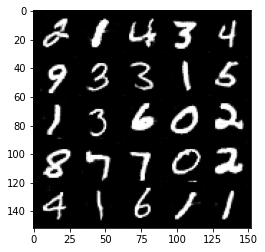

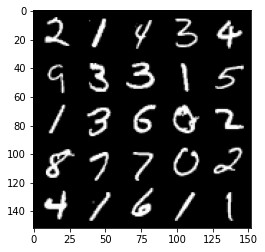

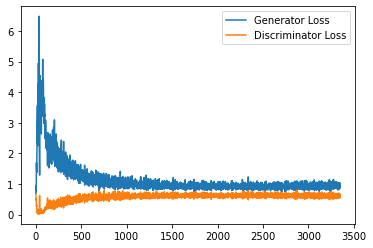

Step 67500: Generator loss: 0.9421633718013763, Discriminator's loss: 0.6144530283808708


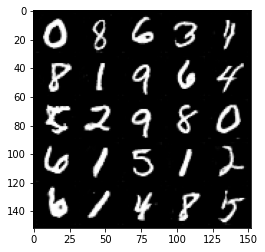

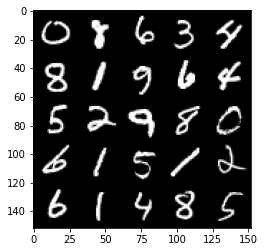

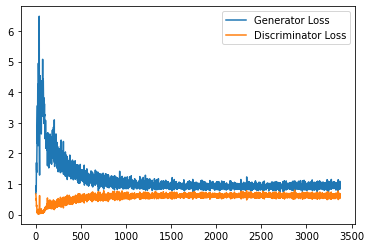

Step 68000: Generator loss: 0.95134505712986, Discriminator's loss: 0.6114322601556778


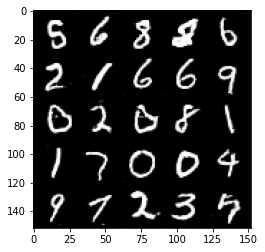

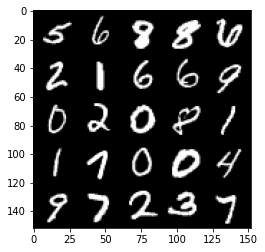

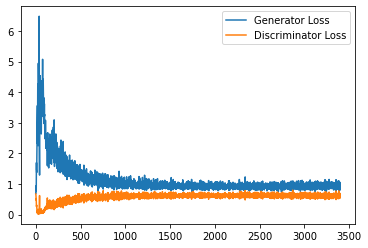

Step 68500: Generator loss: 0.927115891456604, Discriminator's loss: 0.6127238509654999


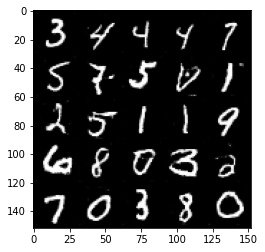

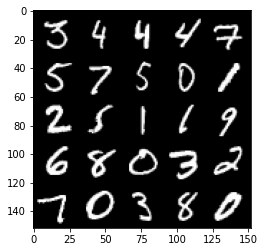

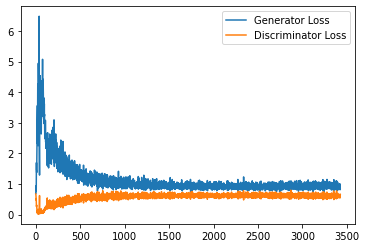

Step 69000: Generator loss: 0.9461004818677903, Discriminator's loss: 0.6121437530517578


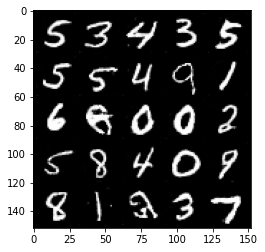

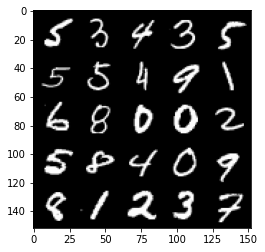

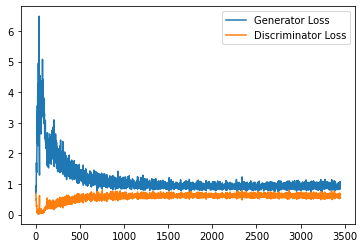

Step 69500: Generator loss: 0.9505787129402161, Discriminator's loss: 0.6123840807080269


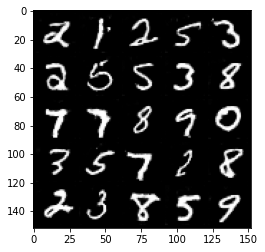

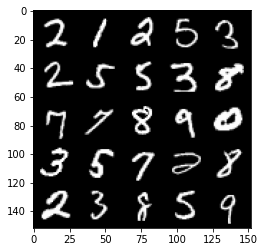

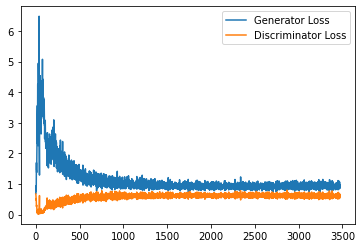

Step 70000: Generator loss: 0.954994297504425, Discriminator's loss: 0.6097329207062722


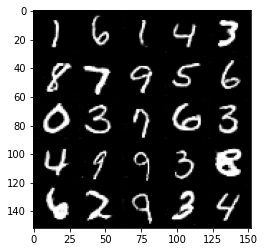

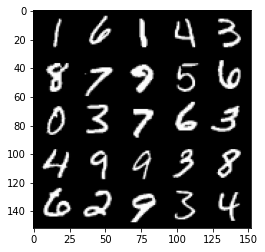

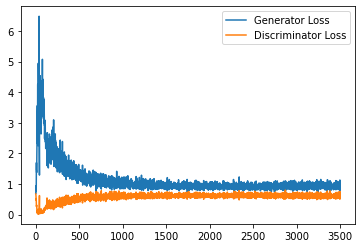

Step 70500: Generator loss: 0.9429814642667771, Discriminator's loss: 0.6126642256975174


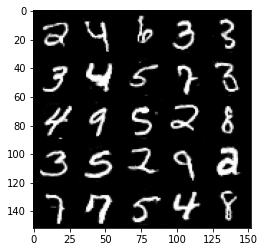

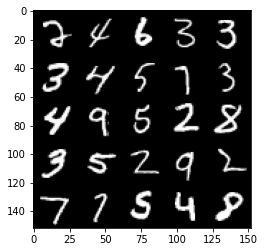

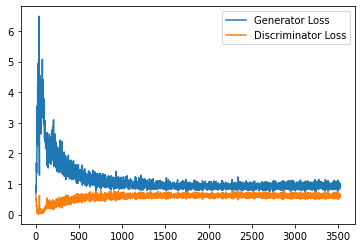

Step 71000: Generator loss: 0.9432136474847793, Discriminator's loss: 0.6149831516742706


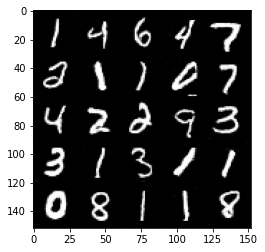

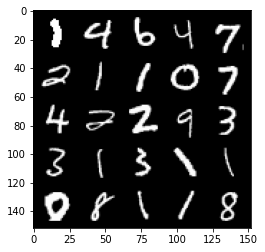

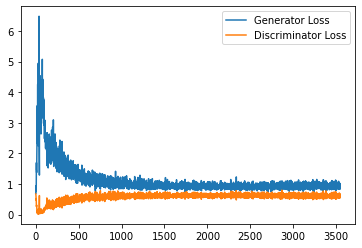

Step 71500: Generator loss: 0.9433066846132279, Discriminator's loss: 0.613495916903019


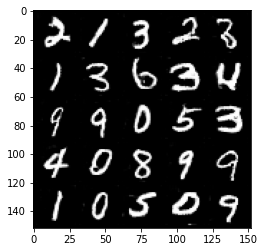

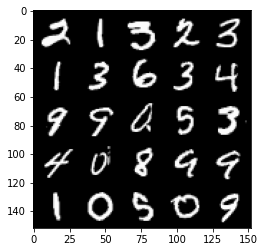

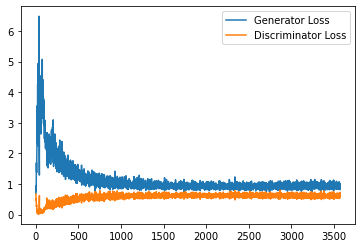

Step 72000: Generator loss: 0.9506385167837142, Discriminator's loss: 0.6153990494012833


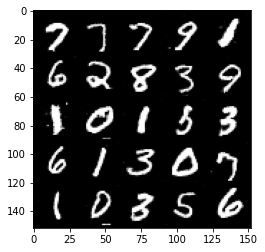

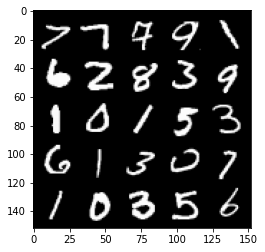

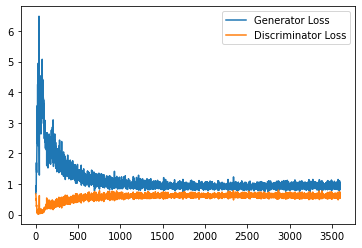

Step 72500: Generator loss: 0.9436865644454956, Discriminator's loss: 0.6108303988575935


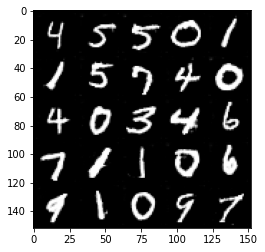

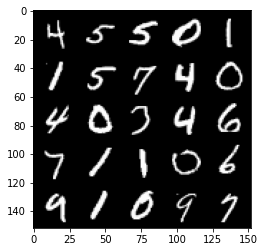

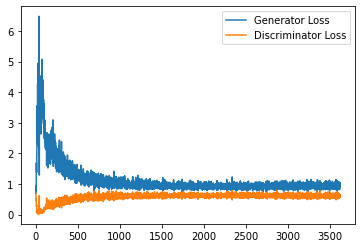

Step 73000: Generator loss: 0.9566343539953232, Discriminator's loss: 0.6141627233028412


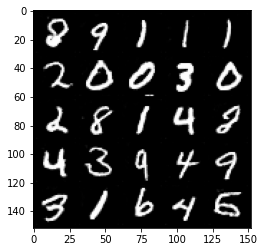

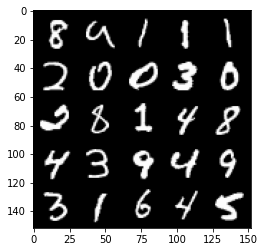

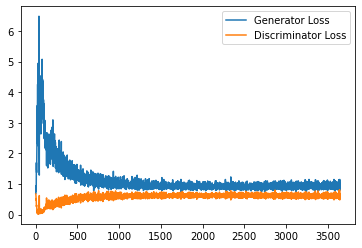

Step 73500: Generator loss: 0.9352131028175354, Discriminator's loss: 0.6131428138017655


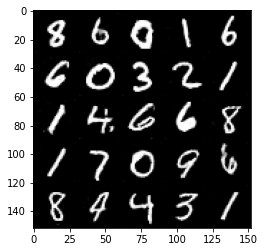

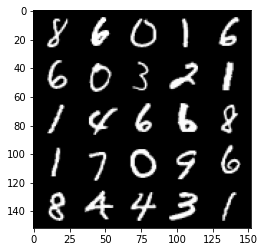

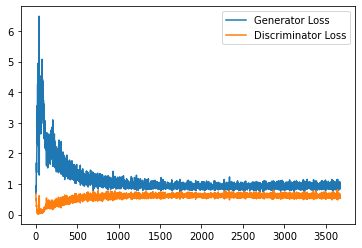

Step 74000: Generator loss: 0.9381289995908737, Discriminator's loss: 0.6127601329088211


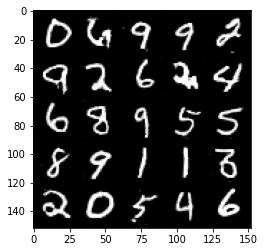

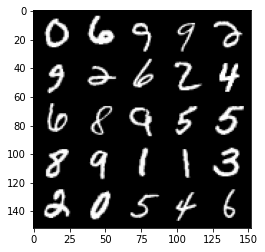

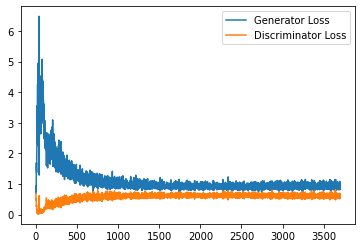

Step 74500: Generator loss: 0.9469116060733795, Discriminator's loss: 0.6154356481432914


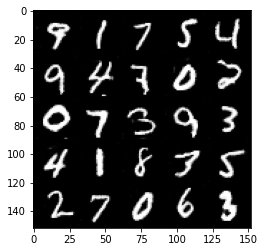

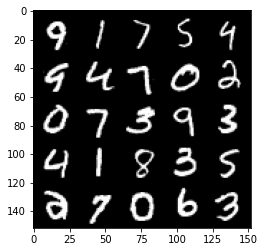

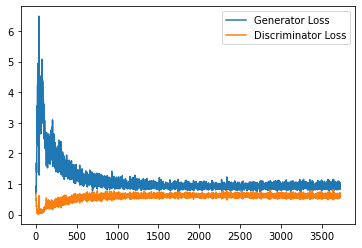

Step 75000: Generator loss: 0.9818984875679017, Discriminator's loss: 0.6041168476939202


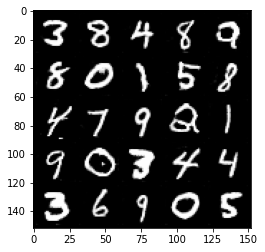

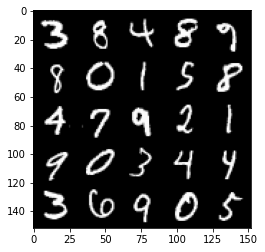

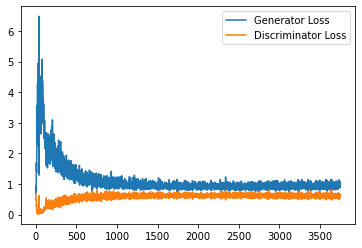

Step 75500: Generator loss: 0.9678817714452743, Discriminator's loss: 0.6052641912698745


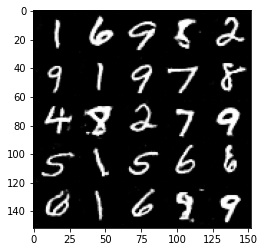

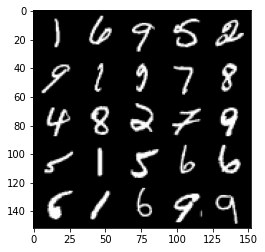

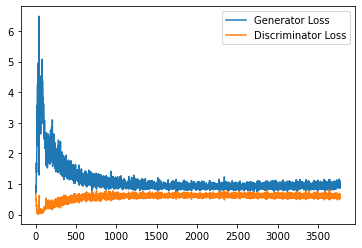

Step 76000: Generator loss: 0.9402115375995636, Discriminator's loss: 0.6114624866843223


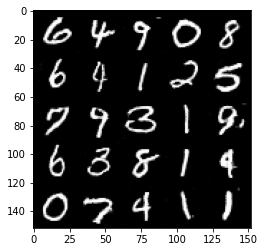

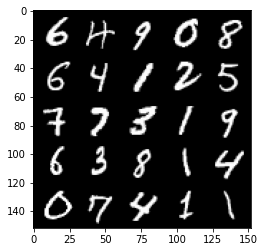

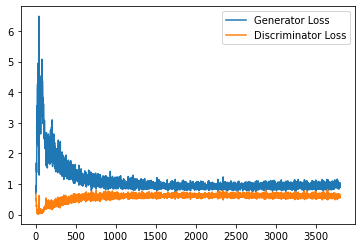

Step 76500: Generator loss: 0.935638069987297, Discriminator's loss: 0.6189786116480828


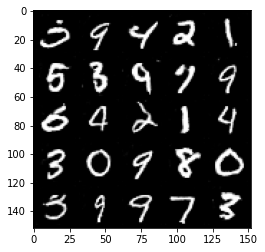

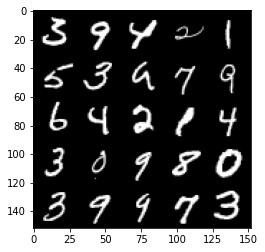

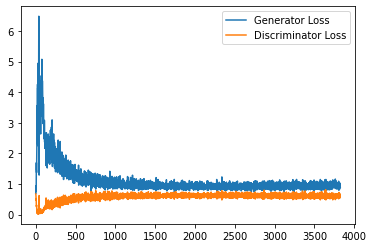

Step 77000: Generator loss: 0.9518737386465073, Discriminator's loss: 0.6109024499654769


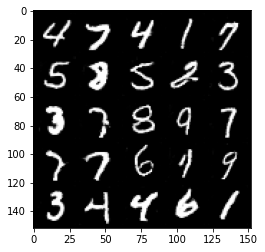

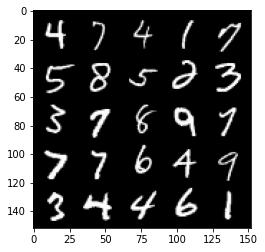

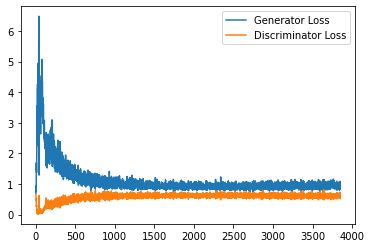

Step 77500: Generator loss: 0.9675250970125199, Discriminator's loss: 0.6134256887435913


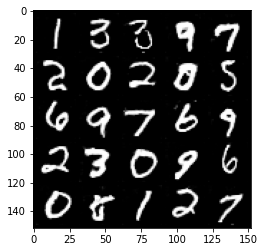

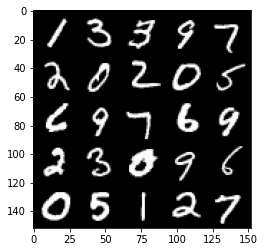

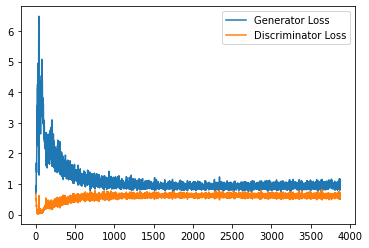

Step 78000: Generator loss: 0.9781547893285751, Discriminator's loss: 0.6081232259869576


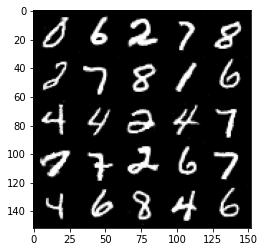

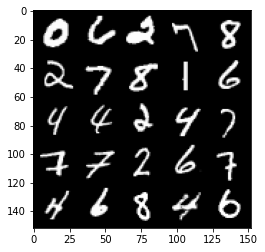

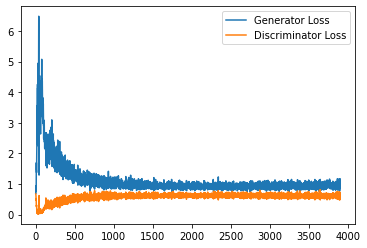

Step 78500: Generator loss: 0.9396690412759781, Discriminator's loss: 0.6120398154854775


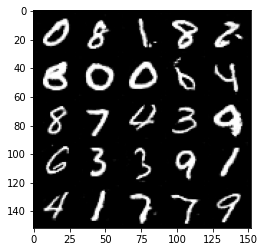

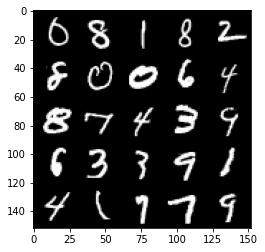

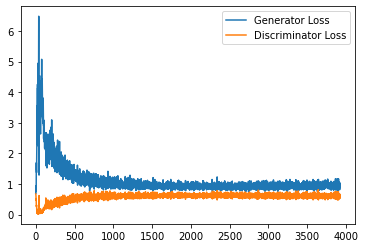

Step 79000: Generator loss: 0.9383969161510467, Discriminator's loss: 0.6208153212666512


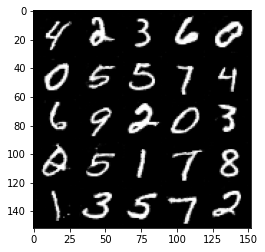

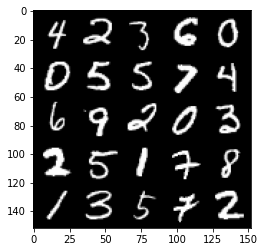

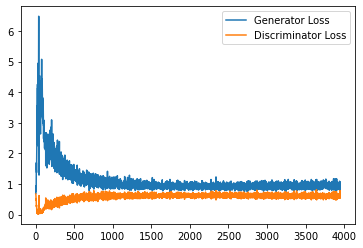

Step 79500: Generator loss: 0.9483971025347709, Discriminator's loss: 0.6108698534965515


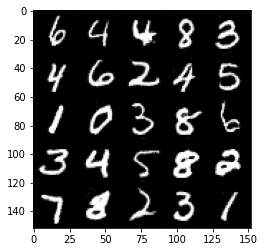

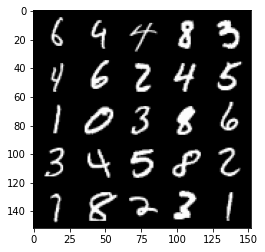

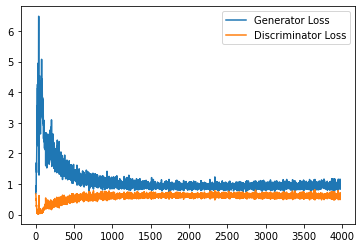

Step 80000: Generator loss: 0.9581546771526337, Discriminator's loss: 0.6038367213010788


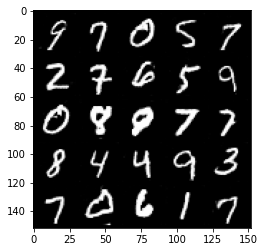

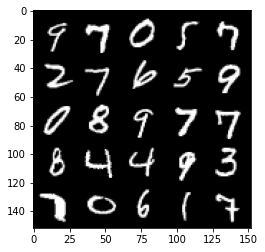

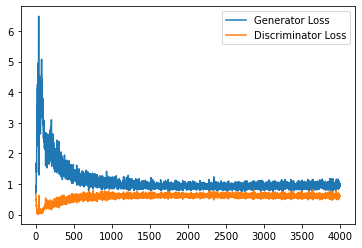

Step 80500: Generator loss: 0.9613931527137757, Discriminator's loss: 0.613756630897522


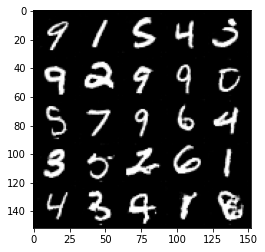

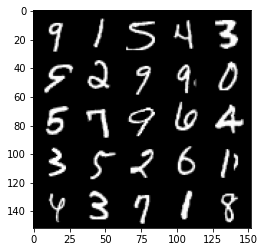

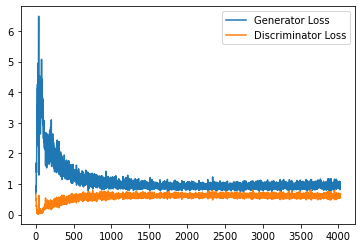

Step 81000: Generator loss: 0.9579600275754928, Discriminator's loss: 0.6116395805478096


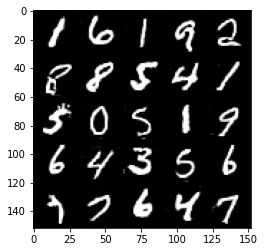

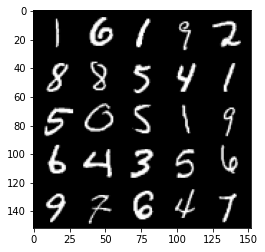

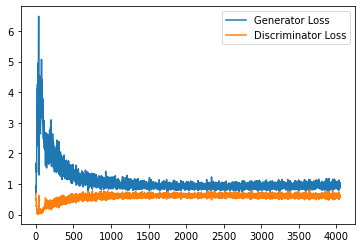

Step 81500: Generator loss: 0.9529491064548492, Discriminator's loss: 0.608578750371933


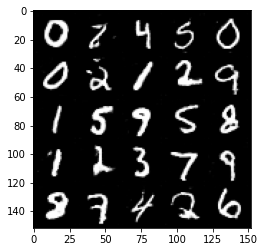

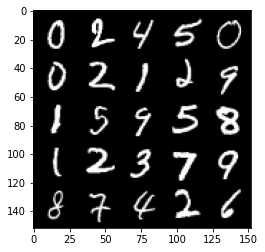

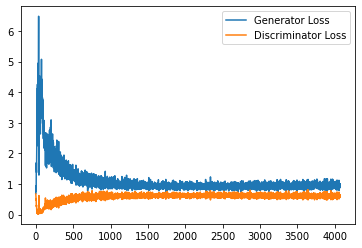

Step 82000: Generator loss: 0.9571191456317901, Discriminator's loss: 0.6105270120501518


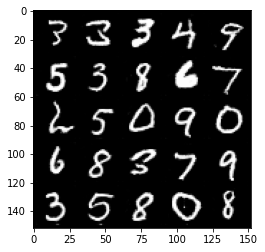

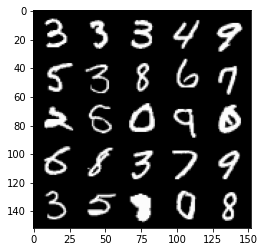

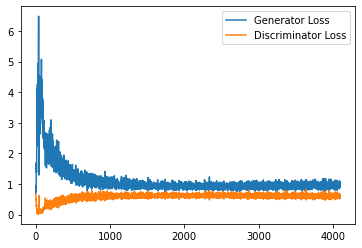

Step 82500: Generator loss: 0.9385785193443298, Discriminator's loss: 0.6155069272518158


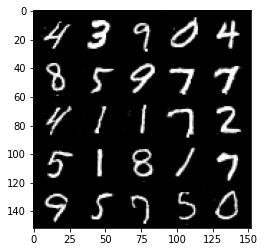

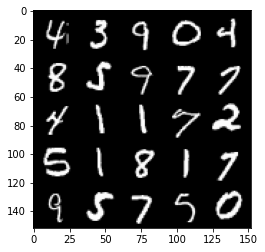

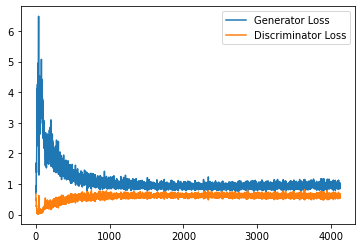

Step 83000: Generator loss: 0.95034783577919, Discriminator's loss: 0.6123791904449463


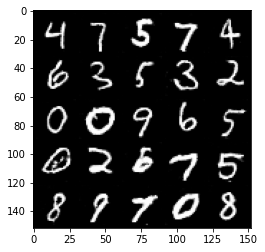

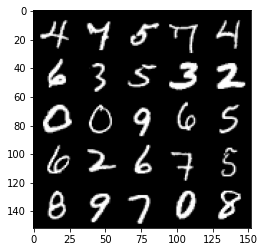

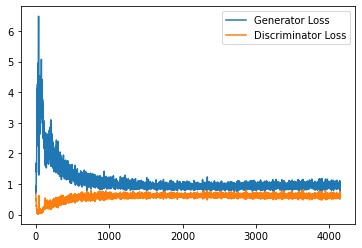

Step 83500: Generator loss: 0.9613839409351349, Discriminator's loss: 0.6134593456387519


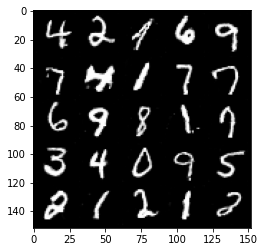

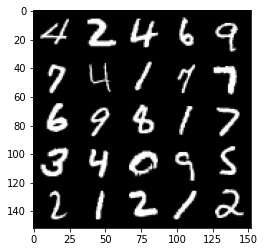

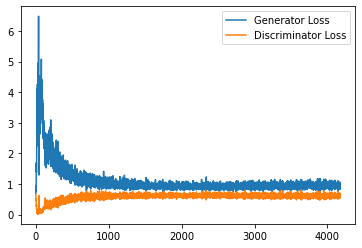

Step 84000: Generator loss: 0.9453768726587296, Discriminator's loss: 0.6166318578720092


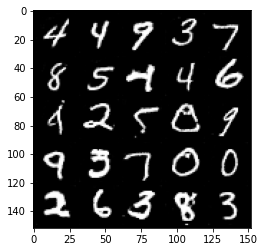

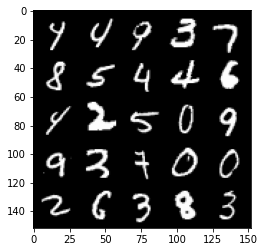

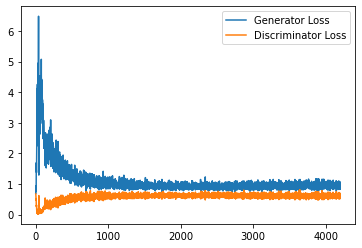

Step 84500: Generator loss: 0.9425919345617294, Discriminator's loss: 0.6142763160467147


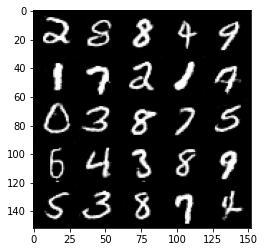

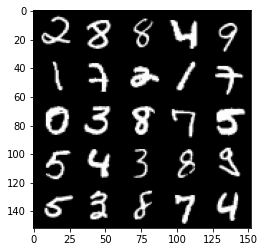

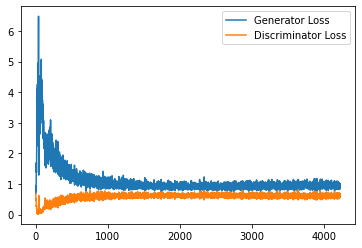

Step 85000: Generator loss: 0.9524201537370682, Discriminator's loss: 0.6108576955199242


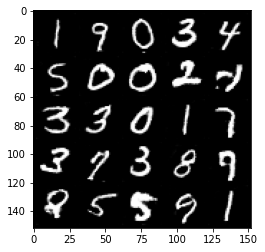

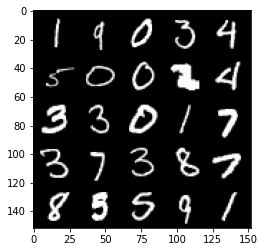

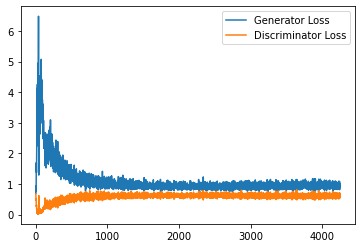

Step 85500: Generator loss: 0.9560052100419998, Discriminator's loss: 0.6123535680174828


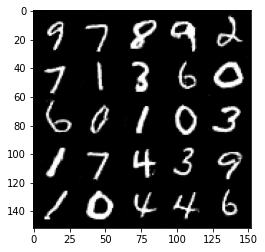

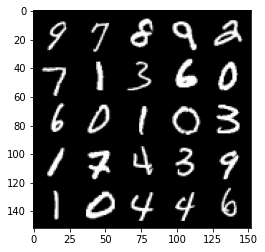

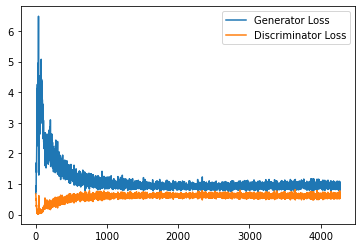

Step 86000: Generator loss: 0.9444885029792786, Discriminator's loss: 0.6219739235043525


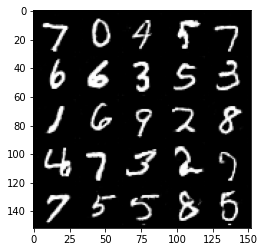

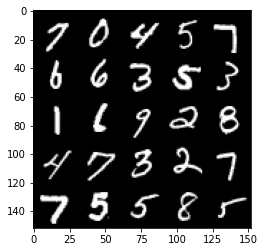

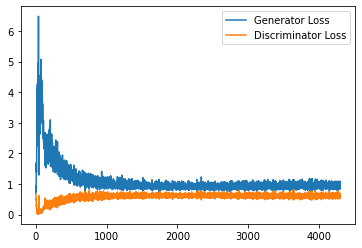

Step 86500: Generator loss: 0.9518609701395034, Discriminator's loss: 0.6166308515667915


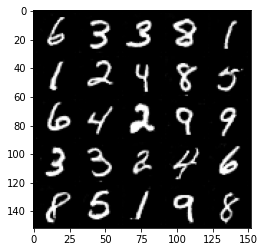

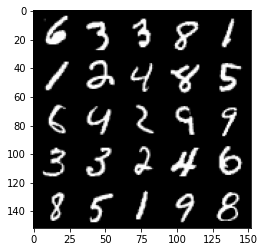

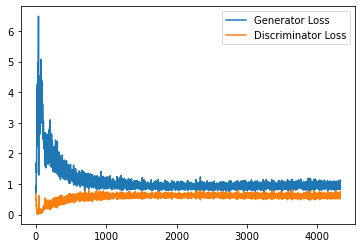

Step 87000: Generator loss: 0.9399338005781174, Discriminator's loss: 0.6247158735394478


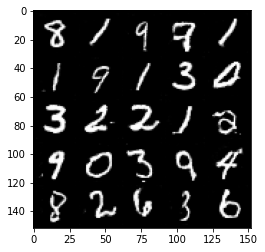

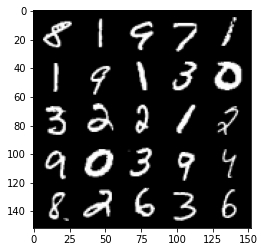

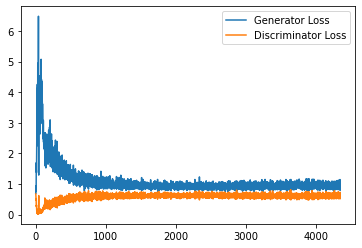

Step 87500: Generator loss: 0.951999127626419, Discriminator's loss: 0.6130435546636581


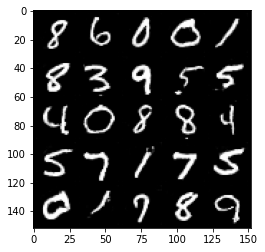

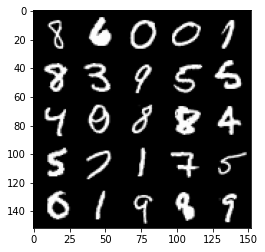

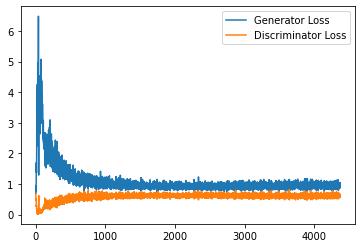

Step 88000: Generator loss: 0.9405314650535583, Discriminator's loss: 0.618343224287033


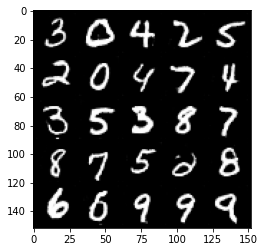

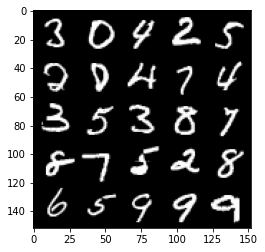

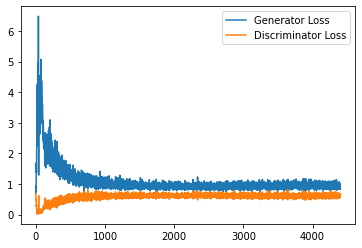

Step 88500: Generator loss: 0.9502571783065796, Discriminator's loss: 0.6121835353374481


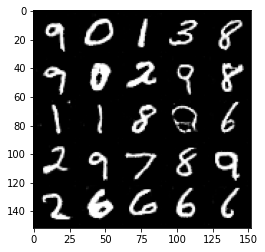

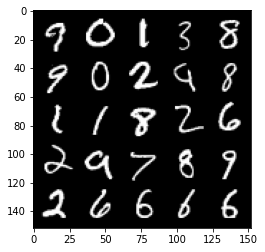

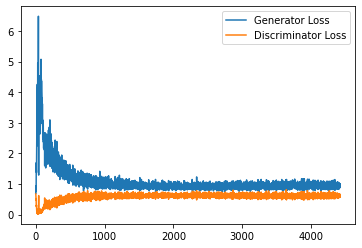

Step 89000: Generator loss: 0.9575125162601471, Discriminator's loss: 0.6153810936212539


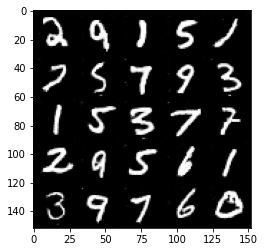

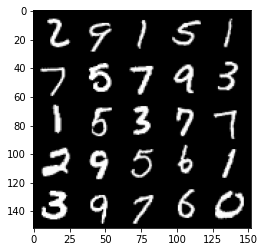

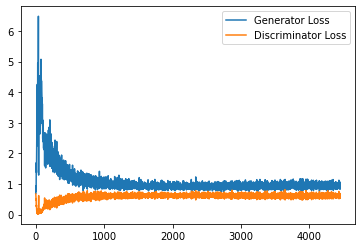

Step 89500: Generator loss: 0.9495977259874344, Discriminator's loss: 0.6178327388763428


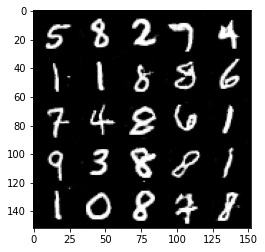

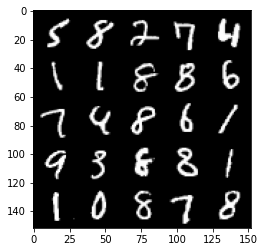

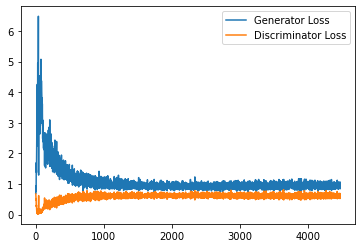

Step 90000: Generator loss: 0.9631280021667481, Discriminator's loss: 0.6105270990729332


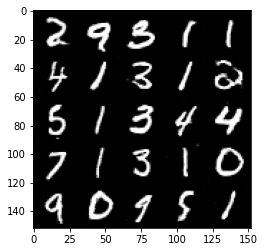

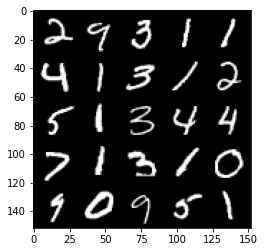

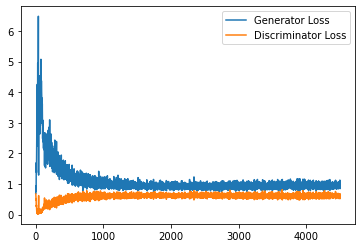

Step 90500: Generator loss: 0.9496557793617248, Discriminator's loss: 0.6225092729926109


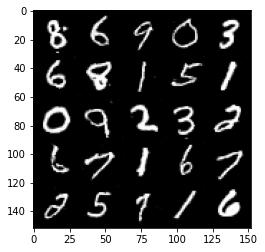

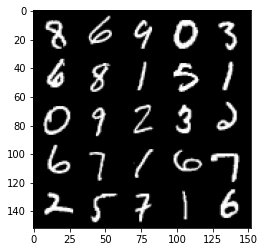

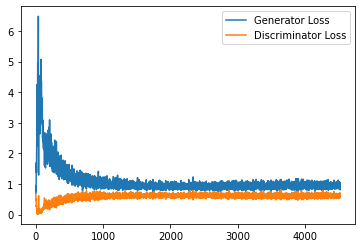

Step 91000: Generator loss: 0.948588020324707, Discriminator's loss: 0.6101166962385177


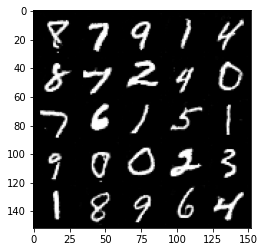

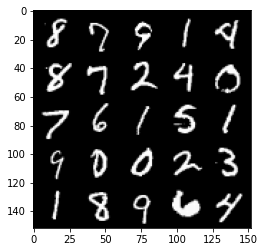

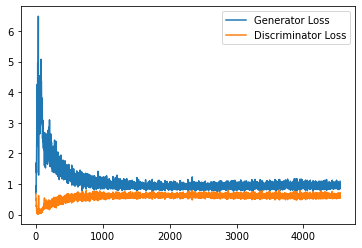

Step 91500: Generator loss: 0.954605934381485, Discriminator's loss: 0.611026095032692


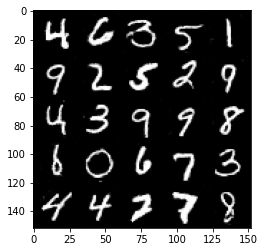

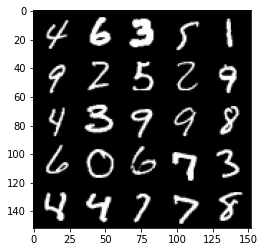

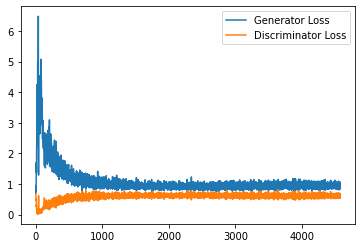

Step 92000: Generator loss: 0.9620248373746872, Discriminator's loss: 0.6122660152316094


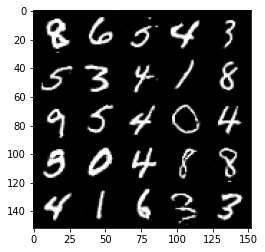

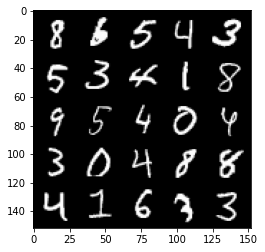

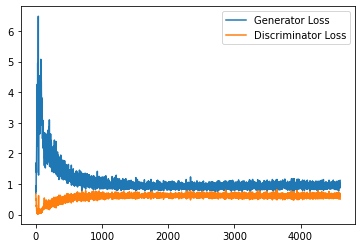

Step 92500: Generator loss: 0.9533285822868347, Discriminator's loss: 0.6192027669548988


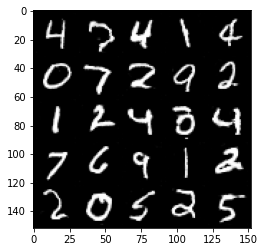

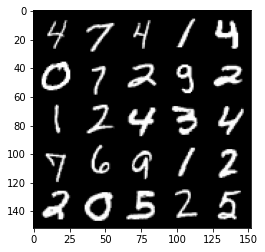

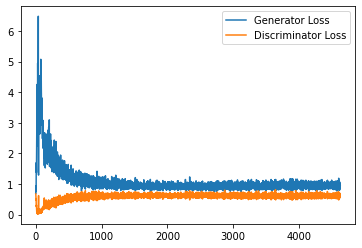

Step 93000: Generator loss: 0.9448681390285492, Discriminator's loss: 0.6182447854876518


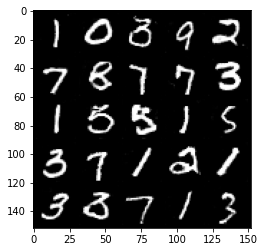

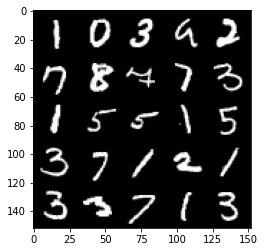

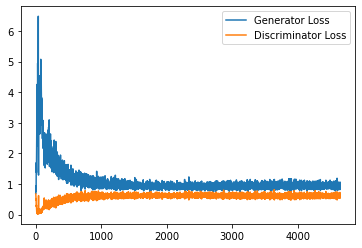

Step 93500: Generator loss: 0.9488723294734955, Discriminator's loss: 0.6161089659333229


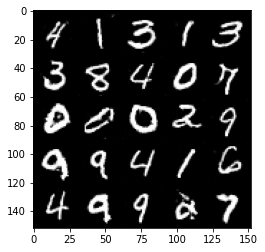

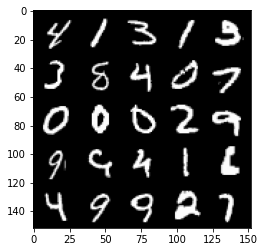

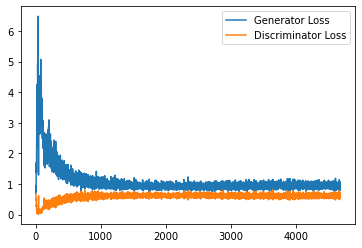

In [9]:
step_i = 0
gen_losses = []
disc_losses = []

for epoch in range(n_epochs):
  # dataloader returns the batches and the labels
  for real_img, labels in tqdm(dataloader):
    batch_size_i = len(real_img)
    # flatten the batch of real images from the dataset
    real_img = real_img.to(device)

    one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
    img_one_hot_labels = one_hot_labels[:,:,None,None]
    img_one_hot_labels = img_one_hot_labels.repeat(1,1,mnist_shape[1], mnist_shape[2])

    ## update the discriminator
    # zero out the discriminator gradients
    disc_opt.zero_grad()
    # get noise corresponding to the current batch size
    noise_vec = get_noise(batch_size_i, noise_dim, device=device)

    ## get images from the generator
    # combine the noise vectors and the one-hot labels
    noise_with_labels = combine_vectors(noise_vec, one_hot_labels)
    # generate the conditioned fake images
    fake_img = gen(noise_with_labels)

    ## get predictions from the discriminator
    # combine the fake images with the img_one_hot_labels
    fake_img_with_labels = combine_vectors(fake_img, img_one_hot_labels)
    # combine the real images with the img_one_hot_labels
    real_img_with_labels = combine_vectors(real_img, img_one_hot_labels)
    # get the discriminator's prediction on the generator's fake images, after detaching the generator to prevent backpropagation
    fake_pred = disc(fake_img_with_labels.detach())
    # get the discriminator's prediction on the real images
    real_pred = disc(real_img_with_labels.detach())

    # calculate discriminator's loss
    fake_loss = criterion(fake_pred, torch.zeros_like(fake_pred))
    real_loss = criterion(real_pred, torch.ones_like(real_pred))
    disc_loss = (fake_loss + real_loss) / 2
    # update gradients
    disc_loss.backward(retain_graph=True)
    # update optimizer
    disc_opt.step()

    # keep track of the discriminator losses
    disc_losses += [disc_loss.item()]

    ## update generator
    # zero out the generator's gradients
    gen_opt.zero_grad()
    fake_img_with_labels = combine_vectors(fake_img, img_one_hot_labels)
    fake_pred = disc(fake_img_with_labels) #without detaching the generator
    # calculate loss
    gen_loss = criterion(fake_pred, torch.ones_like(fake_pred))
    # update gradients
    gen_loss.backward()
    # update optimizer
    gen_opt.step()

    # keep track of the generator losses
    gen_losses  += [gen_loss.item()]

    ## Visualization
    if step_i % viz_step == 0 and step_i > 0:
      gen_mean_losses = sum(gen_losses[-viz_step:]) / viz_step
      disc_mean_losses = sum(disc_losses[-viz_step:]) / viz_step
      print(f"Step {step_i}: Generator loss: {gen_mean_losses}, Discriminator's loss: {disc_mean_losses}")
      tensor_image_viz(fake_img)
      tensor_image_viz(real_img)
      step_bins = 20
      x_axis = sorted([i*step_bins for i in range(len(gen_losses) // step_bins)] * step_bins)
      num_examples = (len(gen_losses) // step_bins) * step_bins
      plt.plot(
          range(num_examples//step_bins),
          torch.Tensor(gen_losses[:num_examples]).view(-1, step_bins).mean(1),
          label = 'Generator Loss'
      )
      plt.plot(
          range(num_examples//step_bins),
          torch.Tensor(disc_losses[:num_examples]).view(-1, step_bins).mean(1),
          label = 'Discriminator Loss'
      )
      plt.legend()
      plt.show()
    step_i += 1






# Evaluating the results

In [18]:
# Put the generator in eval mode
gen = gen.eval()


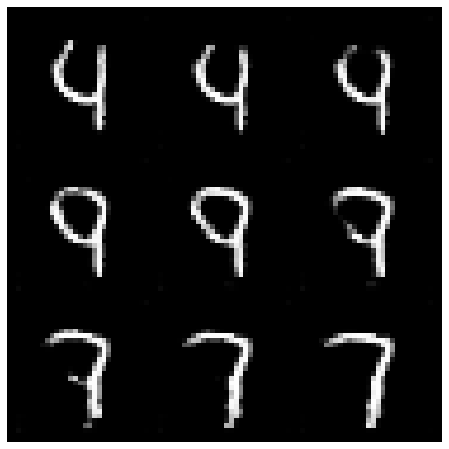

In [23]:
import math

n_interpolation = 9 # number of intermediate images wanted + 2 (including the start and end image)
interpolation_noise = get_noise(1, noise_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
  first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
  second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

  # calculate the interpolation vector between the two vectors
  percent_second_label = torch.linspace(0,1,n_interpolation)[:, None]
  interpolation_labels = first_label*(1-percent_second_label) + second_label*(percent_second_label)

  # combine the noise and the labels
  noise_with_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
  fake_img = gen(noise_with_labels)
  tensor_image_viz(fake_img, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

start_plot_number = 4 # choose the start digit
end_plot_number = 7 # choose the end digit

plt.figure(figsize=(8,8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')



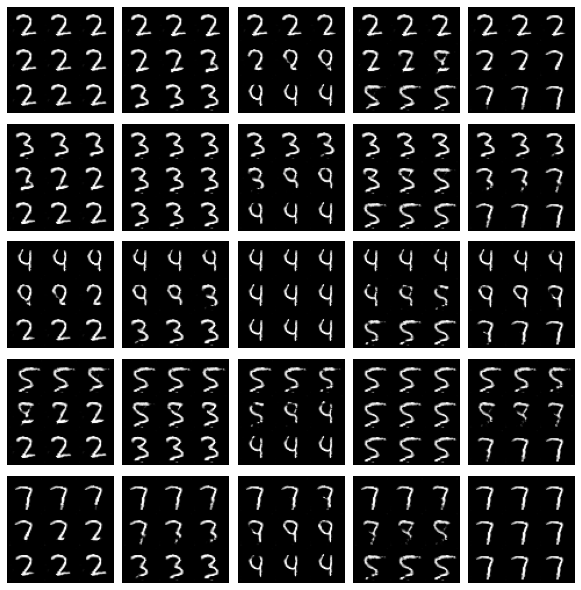

In [24]:
# to visualize a set of pairwise class interpolations 
#for a collection of different number, all in a single grid
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

## Changing the Noise Vector

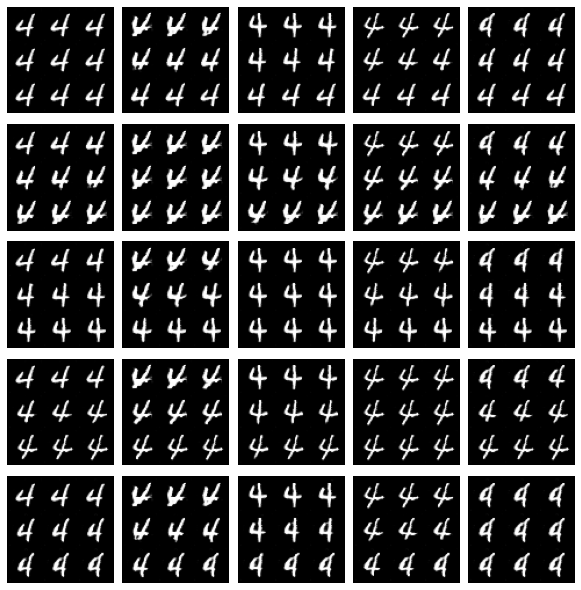

In [40]:
n_interpolation = 9 # number of intermediate images wanted + 2 (for the start and end image)

chosen_class = 4 # class of interest
label = get_one_hot_labels(torch.Tensor([chosen_class]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # for interpolating between the noise vectors
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels 
    noise_with_labels = combine_vectors(interpolation_noise, label.to(device))
    fake_img = gen(noise_with_labels)
    tensor_image_viz(fake_img, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# For generating noise vectors to interpolate between

n_noise = 5 # number of noise examples in the grid
plot_noises = [get_noise(1, noise_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()